In [132]:
import urllib.request
import json
import pandas as pd
import re
import networkx as nx
import unidecode
import nltk
# nltk.download('all')
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import numpy as np
import powerlaw
from nltk.text import Text
import cv2
import requests
import requests 
from bs4 import BeautifulSoup
from kaggle.api.kaggle_api_extended import KaggleApi
import zipfile
from wordcloud import WordCloud
import networkx.algorithms.community as nx_comm
from community import community_louvain
from nltk.tokenize import WordPunctTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from collections import Counter
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import statistics
import plotly_express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from PIL import Image
import seaborn as sns
sns.set_theme(style="darkgrid")

In [2]:
import warnings
warnings.filterwarnings('ignore')
font = {'weight' : 'normal',
        'size'   : 15}

plt.rc('font', **font)

In [3]:
def add_y_values_to_plot(x_vals, y_vals, is_float=True):
    # zip joins x and y coordinates in pairs
    for x,y in zip(x_vals,y_vals):
        
        if is_float:
            label = f"{y:.2f}"
        else:
            label = f"{y}"
            
        plt.annotate(label, # this is the text
                     (x,y), # these are the coordinates to position the label
                     textcoords="offset points", # how to position the text
                     xytext=(0,10), # distance from text to points (x,y)
                     ha='center') # horizontal alignment can be left, right or center


# Gathering data for analysis

To explore The Office, we use several datasets: 

 - We first extract all the characters that played in the Office from season 1 to season 9 (final). This is extracted using **Dunderpedia: The Office Wiki**: https://theoffice.fandom.com/
 
 
 - A description of each character is downloaded from the same source: **Dunderpedia: The Office Wiki**. This data is used to extract the sentiment of each character and will later be compared to the sentiment extracted from the episodes transcripts. We would like to validate that the character description is based on the character developemnt over all seasons. 
 
 
 - We then want to analyse episodes ratings The Office and how they change overtime. We use the **IMDb**  to extract: episode title, IMDb rating, total votes ad air date. The source is: https://www.imdb.com/title/tt0386676/episodes/_ajax
 
 
 - From Kaggle we download the guest starts, directors adn writers https://www.kaggle.com/nehaprabhavalkar/the-office-dataset. We use this data to analyse the impact of guest starts, directors and writers in the ratings. 
 
 
 - Next, to further analyse the episodes raitings, we want to get information about the episode itself, such as the characters that played in it, how many lines they had in every episode and so on. This is collected from a **Kaggle dataset: The Office (US) - Complete Dialogue/Transcript**
https://www.kaggle.com/nasirkhalid24/the-office-us-complete-dialoguetranscript/version/1?select=The-Office-Lines.csv

# Building the network - Dunderpedia: The Office Wiki

**To create our network, we downloaded the Dunderpedia: The Office Wiki pages for all characters in the series and linked them via the hyperlinks connecting pages to each other by examining their contents. To achieve this goal we have used regular expressions!**

Using the Dunderpedia API, we need to extract all the character names.

This data is located in the Characters category: https://theoffice.fandom.com/wiki/Category:Characters. To extract the data in this category, we need to make an API request to the API baseurl https://theoffice.fandom.com/api.php. Then we need build the baseurl with the following parameters: 
- `action=query`: to fetch information about from the Dunderpedia wiki source.
- `cmtitle=Category:Characters`: Using the cmtitle parameter we specify which category we want to enumerate. 
- `list=categorymembers&cmlimit=max`: We make sure to include all the characters by setting the `cmlimit` paramater to maximum. Otherwise, not all characters will be included in the result. 

In [4]:
baseurl = "https://theoffice.fandom.com/api.php?" # the baseurl to build the API query to the character pages
action = "action=query"

# we create the title for the page we want to extract the content from
title = "cmtitle=Category:Characters"

# add the parameter list=categorymembers to the query's content
content = "list=categorymembers&cmlimit=max"
dataformat ="format=json" # we want the return of the query to be json for future use when we extract the contents

# construct the query for the title
category_query = f"{baseurl}{action}&{content}&{title}&{dataformat}"
print(f"For title: {title.split('=')[1]}, the query is: {category_query}")

For title: Category:Characters, the query is: https://theoffice.fandom.com/api.php?action=query&list=categorymembers&cmlimit=max&cmtitle=Category:Characters&format=json


Once the category query has been built, we need to make the actual request to extract each of the character page title and id from the `categorymemebers`section. These will be then used for building the queries to extract the actual information about the characters: 

In [5]:
response = urllib.request.urlopen(category_query) # make the request to the query
data_response = response.read().decode('utf-8') # read the response and decode it
data_json = json.loads(data_response)['query']['categorymembers'] # convert the response to json format

page_ids = []
titles = []

for category in data_json:
    # we keep a list with the page indexes and titles to be used when extracting the content for the category pages
    page_ids.append(category['pageid'])
    titles.append(category['title'].replace(' ', '_'))

The above query, returns not only the character names, but also the categories the characters are divided into. Looking at the data we identified 5 main categories, and 18 subcategories. We extract them and separate them from the character names. These categories will be used later in the analysis. 


In [6]:
main_categories = list(map(lambda title: title.casefold(), titles[:5]))
sub_categories = list(map(lambda title: title.casefold().replace('category:', ''), titles[-18:]))
characters = titles[5:-18]

In [7]:
print(f"Main categories: {main_categories}\n")
print(f"Sub categories: {sub_categories}")

Main categories: ['background_employees', 'clients_of_dunder_mifflin', 'main_characters', 'mentioned_characters', 'voiced_characters']

Sub categories: ['actors_of_the_3rd_floor', 'actors_of_threat_level_midnight', 'animals', 'characters_of_dwight_schrute', 'characters_of_michael_scott', 'deceased_characters', 'dunder_mifflin_employees', 'family_members', 'females', 'former_employees', 'it_guys', 'main_characters', 'males', 'the_3rd_floor_characters', 'threat_level_midnight_characters', 'unnamed', 'unseen_characters', 'warehouse_worker']


Now that we have the correct titles and ids for each of the character pages, we can make the API queries to extract the content of each page. This content will later be used in order to extract the characters information and hyperlinks. This will help in the future analysis and network construction.  

To do this we make an API request. We again use baseurl `https://theoffice.fandom.com/api.php?` and title for each of the characters, and we built related API queries for each of them. Then, we made the requests for each query. For each character, we save the resulting page content in a txt file.

In [8]:
content = "prop=revisions&rvprop=content&rvslots=*"

queries = []
page_ids = page_ids[5:-18]
for i, page_id in enumerate(page_ids):
    title = characters[i]
    query = f"{baseurl}{action}&{content}&titles={title}&{dataformat}"
    queries.append(query)
    print(f"For title: {title}, the query is: {query}")

For title: A.J., the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=A.J.&format=json
For title: Abby, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Abby&format=json
For title: Alan, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alan&format=json
For title: Alan_Brand, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alan_Brand&format=json
For title: Alex, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alex&format=json
For title: Alice, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alice&format=json
For title: Amy, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslot

Next we follow the strategy we used to download the pages above, to download each character page. For each character, we save the resulting page content in a txt file.

In [9]:
def get_character_roles(content):
    roles = {'Main Role': '', 'Secondary Roles': []}
    pattern = r'(?:\[\[Category\:)(.*?)\]\]'
    matches = re.findall(pattern, content)
    
    for match in matches:
        if match.casefold().replace(' ', '_') in main_categories: 
            roles['Main Role'] = match
        elif match.casefold().replace(' ', '_') in sub_categories: 
            roles['Secondary Roles'].append(match)
    return roles

In [10]:
contents = {'Name': [], 'Main Role': [], 'Secondary Roles': []} # dictionary storing the charactes contents - will later be used to build the dataframe

for i, query in enumerate(queries):
    # make the actual requests using the urllib library for each of the previoysly initialized queries
    response = urllib.request.urlopen(query) # make the request to the query
    data_response = response.read().decode('utf-8') # read the response and decode it

    data_json = json.loads(data_response) # convert the response to json format
    name = data_json['query']['pages'][str(page_ids[i])]['title']
   
    contents['Name'].append(name) # add character name
    
    # the content that we want to find in the initial page is located at query/pages/'index'/revisions[0]/slots/main/*
    content = data_json['query']['pages'][str(page_ids[i])]['revisions'][0]['slots']['main']['*']
    
    roles = get_character_roles(content) # add character main and secondary roles
    if 'Main Role' in roles:
        contents['Main Role'].append(roles['Main Role'])
    if 'Secondary Roles' in roles:
        contents['Secondary Roles'].append(roles['Secondary Roles'])
    with open(f'./data/characters/{name}.txt', 'w+') as file:
        file.write(content)

#### Extract characters branches (workplace)

Next we are going to extract the different branches of Dunder Mifflin to see in which branch and department every character works at, so we can group them in communities. 

Using the following page inside the Dunderpedia: https://theoffice.fandom.com/wiki/Branch_(disambiguation), we can see that they are 8 branches. For each branch, we make a request and extract the characters belonging to each branch. Then we add this information to the character dataframe.

We construct the queries in the same way as before. Since now we have to make 8 queries, we manually extracted the page ids and titles for each of the pages:

In [11]:
content = "prop=revisions&rvprop=content&rvslots=*"

branch_queries = []
page_ids_branches = [1657, 2011, 2092, 1765, 9709, 2095]
titles_branches = ['Dunder_Mifflin_Scranton', 'Dunder_Mifflin_Albany', 
                   'Dunder_Mifflin_Nashua', 'Dunder_Mifflin_Corporate_Office', 
                   'Dunder_Mifflin_Syracuse', 'Dunder_Mifflin_Utica']
for title in titles_branches:
    query = f"{baseurl}{action}&{content}&titles={title}&{dataformat}"
    branch_queries.append(query)
    print(f"For title: {title}, the query is: {query}")

For title: Dunder_Mifflin_Scranton, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Dunder_Mifflin_Scranton&format=json
For title: Dunder_Mifflin_Albany, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Dunder_Mifflin_Albany&format=json
For title: Dunder_Mifflin_Nashua, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Dunder_Mifflin_Nashua&format=json
For title: Dunder_Mifflin_Corporate_Office, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Dunder_Mifflin_Corporate_Office&format=json
For title: Dunder_Mifflin_Syracuse, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Dunder_Mifflin_Syracuse&format=json
For title: Dunder_Mifflin_Utica, the query is: https://theoffice.fandom.com/a

Next we make the actual requests and extract the branch and department for the characters listed in the above pages. note that employees can have more than one branch and one department, as this develops during the series.

In [12]:
def get_chraracter_position(title, content):
    pattern = r'\[\[(.*?)(?:\|.*?)?\]\](?:.*?)(?:\- )(.*?)(?:\;|\,|\n|\<small\>)'
    matches = re.findall(pattern, content)
    for match in matches:
        character = match[0]
        role = match[1]
        try:
            index = contents['Name'].index(character)
            contents['Position'][index].append(role)
            contents['Branch'][index].append(title.replace('_', ' '))
        except ValueError: # character not present in the list of saved characters
            continue

In [13]:
contents['Position'] = [[] for i in range(len(contents['Name']))]
contents['Branch'] = [[] for i in range(len(contents['Name']))]

for i, query in enumerate(branch_queries):
    # make the actual requests using the urllib library for each of the previoysly initialized queries
    response = urllib.request.urlopen(query) # make the request to the query
    data_response = response.read().decode('utf-8') # read the response and decode it

    data_json = json.loads(data_response) # convert the response to json format
    name = data_json['query']['pages'][str(page_ids_branches[i])]['title']
       
    # the content that we want to find in the initial page is located at query/pages/'index'/revisions[0]/slots/main/*
    content = data_json['query']['pages'][str(page_ids_branches[i])]['revisions'][0]['slots']['main']['*']
    
    get_chraracter_position(titles_branches[i], content) # add character position and branch to contents dictionary

#### Extract character links

Now we have extracted the contents from each character, each page will correspond to a character, which is a node in our network. Next we take the pages we have downloaded for each character. We now find all the hyperlinks in a character's page that link to another node of the network (e.g. another character). For this we use regular expressions.

In [14]:
def get_links(content):
    pattern1_matches = re.findall(r'\[\[(.*?)(?:\|.*?)?\]\]', content)
        
    # we need to check if the found matches are characters (i.e. they are present in the extracted df)
    pattern1_matches = list(filter(lambda x: x in list(contents['Name']), pattern1_matches))
    return pattern1_matches

In [15]:
links = []

for name in contents['Name']:
    with open(f'./data/characters/{name}.txt') as file:
        content = file.read()
        # use the get_links to extract the links using a regrex expression
        links.append(get_links(content))

Next we create a dataframe with the character names, main and secondary roles and links, and we save this data as csv

In [16]:
df = pd.DataFrame.from_dict(contents)

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 298 entries, 0 to 297
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Name             298 non-null    object
 1   Main Role        298 non-null    object
 2   Secondary Roles  298 non-null    object
 3   Position         298 non-null    object
 4   Branch           298 non-null    object
dtypes: object(5)
memory usage: 11.8+ KB


In [18]:
df.insert(5, 'Links', links) # add all genders to dataframe

In [19]:
df.head() # display the new dataframe with the 3 new columns

,Name,Main Role,Secondary Roles,Position,Branch,Links
0,A.J.,,[Males],[A salesman and ex-boyfriend of [[Holly Flax|H...,[Dunder Mifflin Nashua],"[Holly Flax, Holly Flax, Michael Scott, Pam Be..."
1,Abby,,"[Females, Family members]",[],[],"[Stacy, Pam Beesly]"
2,Alan,,[],[],[],"[Kelly Kapoor, Ryan Howard, Pam Beesly]"
3,Alan Brand,,"[Dunder Mifflin employees, Former employees, M...",[CEO ],[Dunder Mifflin Corporate Office],"[Jan Levinson, Michael Scott, Oscar Martinez, ..."
4,Alex,,[Males],[],[],"[Pam Beesly, Alex, Karen Filippelli]"


#### Extract characters thumbnails

Next we extract pictures for each character so that we can use them for the network nodes

In [20]:
content = "prop=images&rvprop=content&rvslots=*"

img_queries = []

for i, page_id in enumerate(page_ids):
    title = characters[i]
    query = f"{baseurl}{action}&{content}&titles={title}&{dataformat}"
    img_queries.append(query)
    print(f"For title: {title}, the query is: {query}")

For title: A.J., the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=A.J.&format=json
For title: Abby, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Abby&format=json
For title: Alan, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alan&format=json
For title: Alan_Brand, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alan_Brand&format=json
For title: Alex, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alex&format=json
For title: Alice, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alice&format=json
For title: Amy, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Amy&format

In [21]:
images = {}
errors = []
for i, query in enumerate(img_queries):
    # make the actual requests using the urllib library for each of the previoysly initialized queries
    response = urllib.request.urlopen(query) # make the request to the query
    data_response = response.read().decode('utf-8') # read the response and decode it

    data_json = json.loads(data_response) # convert the response to json format
    name = content = data_json['query']['pages'][str(page_ids[i])]['title']
    
    try:
        # the content that we want to find in the initial page is located at query/pages/'index'/revisions[0]/slots/main/*
         
        img_title = data_json['query']['pages'][str(page_ids[i])]['images'][0]['title']
        img_index = 0
        while 'gif' in img_title:
            img_title = data_json['query']['pages'][str(page_ids[i])]['images'][img_index+1]['title']

        content = 'prop=pageimages'
        query_img = f"{baseurl}{action}&{content}&titles={img_title.replace(' ', '_').replace('&', '%26')}&{dataformat}"
        response = urllib.request.urlopen(query_img) # make the request to the query
        img_response = response.read() # read the response and decode it
        data_json = json.loads(img_response) # convert the response to json format
        pages = data_json['query']['pages']
        
        page = list(pages.values())[0]
        img_url = page['thumbnail']['source']
        img_data = requests.get(img_url).content
        
        extension = img_title.split('.')[-1] if 'gif' not in img_title.split('.')[-1] else 'png'
        path =  "./data/thumbnails/" + characters[i] + "." + extension
        images[characters[i]] = characters[i] + "." + extension

        with open(path, 'wb') as file:
            file.write(img_data)
    except Exception:
        errors.append(characters[i].replace('_', ' '))

Cleanup the dataset and remove all those characters that do not have a thumbnail, they should not be included in the network

In [22]:
df = df[~df['Name'].isin(errors)]

In [23]:
df.insert(4, 'ImagePath', images.values()) # add all races to dataframe

In [24]:
# use the to_csv built in pandas function to save our data to a csv file called characters.csv
df.to_csv('data/characters.csv', index=False)

## Building the Dunderpedia Network

Next, we generate the The Office network directed graph, which includes all the characters in the Office extracted from the Dunderpedia. 

The nodes in the network will be all the characters, and we will place an edge between nodes **A** and **B** if the Dunderpedia wiki page of node **A** links to the Dunderpedia Wiki page of node **B**. 

For every character, we have found their main and secondary roles, their thumnails and their names. This information will be used to identify each node in the network by including an `attribute` for each characteristic. 

We use `NetworkX DiGraph` to store the network and we store also the properties of the nodes (i.e. Main Role, Sub role and Image Path).

In [25]:
G = nx.DiGraph()

# iterate through all the rows in pandas df and add nodes
for index, row in df.iterrows():
    name = row['Name']
    img = row['ImagePath']
    main_role = row['Main Role']
    sub_roles = row['Secondary Roles']
    
    # add node 
    G.add_node(name, img=img, main_role=main_role, sub_roles=sub_roles)
    links = row['Links']
    for link in links:
        if link != name and link in list(df.Name): # do not include links that point to the same character
            G.add_edge(name, link)

We now check for isolated nodes, and we remove them:

In [26]:
print(f"Number of isolated nodes in graph: {len(list(nx.isolates(G)))}")

Number of isolated nodes in graph: 17


In [27]:
G.remove_nodes_from(list(nx.isolates(G))) # remove isolated nodes in graph
print(f"Number of isolated nodes in graph after removal: {len(list(nx.isolates(G)))}")

Number of isolated nodes in graph after removal: 0


For futher analysis, we will work with the Giant Connected Component of our network. We extract the GCC by first conecting it to an undirected graph.

In [28]:
gcc = max(nx.weakly_connected_components(G), key=len) # find the maximum connected component in G
G = G.subgraph(gcc) # the gcc we will operate with
G_undirected = G.to_undirected() # convert gcc to undirected graph

## Network visualization and basic stats

Next, we would like to get some insights into our network. For this, we perform simple network stattictics and analysis. We would also like to visualize the network. Ee use the GCC to report the results.

* **What is the number of nodes in the network?**


In [29]:
print(f"The number of nodes in network is {len(G.nodes())}")

The number of nodes in network is 255


* **What is the number of links?**

In [30]:
print(f"The number of links in network is {len(G.edges())}")

The number of links in network is 1197


* **Who is the top connected character in The Office? (Report results for the in-degrees and out-degrees). Comment on your findings. Is this what you would have expected?**

To calculate the in-degrees and out-degrees we use the `in_degree()` and `out_degree()` functions, respectively. These functions return a collection of tuples representing every node in the network and their respective degree. 

In [31]:
# create a list of tuples containing the node (n) and its degree (d) - for the in and out degrees
in_degrees = [(n,d) for n,d in G.in_degree()] 
out_degrees = [(n,d) for n,d in G.out_degree()]

# sort the in- and out-degrees from high to low by degree (second element in the tuple - at index 1)
in_degrees.sort(reverse=True, key=lambda x: x[1])
out_degrees.sort(reverse=True, key=lambda x: x[1])

print(f"The top connected character in The Office for the in-degrees is: {in_degrees[0][0]}, which has a degree of {in_degrees[0][1]}")
print(f"The top connected character in The Office for the out-degrees is: {out_degrees[0][0]}, which has a degree of {out_degrees[0][1]}")

The top connected character in The Office for the in-degrees is: Michael Scott, which has a degree of 108
The top connected character in The Office for the out-degrees is: Andy Bernard, which has a degree of 33


The top connected character in The Office for the in-degrees is Michael Scott, with a 108 in-degree. Michael is the protagonist of The Office, and Regional Manager of the Scranton branch from season 1 to 7. Hence it makes sense that a lot of characters point to him as he is the main character in The Office and has relations to most of the other chraracters. 

The top connected character in The Office for the out-degrees is Andy Bernard, with a 33 out-degree. In the series, Andy Bernard tries to please everyone, so it makes sense that he is the one pointing to the most characters.

* **Who are the top 5 most connected characters (again in terms of in/out-degree)?**

In [32]:
print(f"The top 5 connected character in The Office for the in-degrees are:")
for n, d in in_degrees[:5]: # iterate through the first five nodes and degrees
    print(f"\t{n}, which has a degree of {d}")
    
print(f"\nThe top 5 connected character in The Office for the out-degrees are:")
for n, d in out_degrees[:5]:
    print(f"\t{n}, which has a degree of {d}")

The top 5 connected character in The Office for the in-degrees are:
	Michael Scott, which has a degree of 108
	Dwight Schrute, which has a degree of 88
	Jim Halpert, which has a degree of 76
	Pam Beesly, which has a degree of 73
	Andy Bernard, which has a degree of 54

The top 5 connected character in The Office for the out-degrees are:
	Andy Bernard, which has a degree of 33
	Michael Scott, which has a degree of 27
	Phyllis Vance, which has a degree of 26
	Pam Beesly, which has a degree of 24
	Dwight Schrute, which has a degree of 24


* **Plot the in- and out-degree distributions.**

To plot the binned in and out degree distributions, we compute the binning vector of both degrees.
To compute the binning vector, we create a list of values spaced by 1 step, where the goal is to have as many bins as unique values in our data such that when the histogram is computed, they range from `min_value` to `max_value`. Hence, when creating the binning-vector, the first element has to be half-step less than the minimum value and the last element half-step more than the maximum value plus one becausethere is one more edge than bins. 

In [33]:
def get_degree_distribution(degrees):
    """
    Organize the degrees in bins so as to plot the binned degree distribution
    """
    max_degree = max(degrees)
    min_degree = min(degrees)

    v = np.arange(min_degree-0.5, max_degree+1.5)
    bins_count, bins = np.histogram(degrees, v)

    # find the middle value between bins and create a new list of bins.
    bins_new = []
    for index, value in enumerate(bins[0:-1]):
        avg = np.mean((value, bins[index+1]))
        bins_new.append(avg)
    
    return bins_new, bins_count

In [34]:
in_degrees = [d for n,d in G.in_degree()] # from the tuple node, degree, get only the degrees
out_degrees = [d for n,d in G.out_degree()]

# compute the degree distribution in bins for the in- and out-degrees
in_bins, in_bins_count = get_degree_distribution(in_degrees)
out_bins, out_bins_count= get_degree_distribution(out_degrees)

Now we plot their distributions and bar and scatter plots:

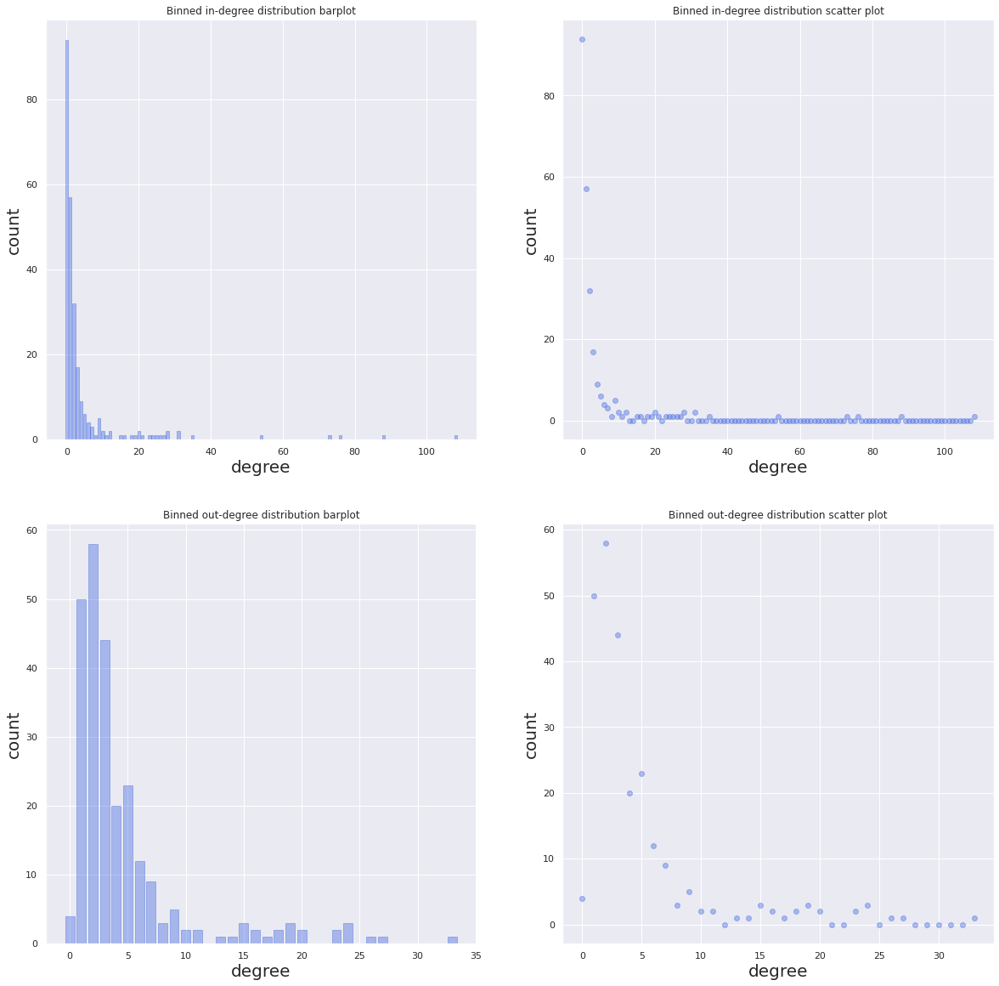

In [35]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))

ax[0][0].bar(in_bins, in_bins_count, width=.8, color='royalblue',alpha=0.4,edgecolor='royalblue')

ax[0][0].set_title('Binned in-degree distribution barplot')
ax[0][0].set_xlabel("degree", fontsize=20)
ax[0][0].set_ylabel("count", fontsize=20)

# we use bar and scatter plots of the same distributions for better visualization purposes
ax[0][1].scatter(in_bins, in_bins_count, color='royalblue',alpha=0.4,edgecolor='royalblue')
ax[0][1].set_title('Binned in-degree distribution scatter plot')
ax[0][1].set_xlabel("degree", fontsize=20)
ax[0][1].set_ylabel("count", fontsize=20)

ax[1][0].bar(out_bins, out_bins_count, width=.8, color='royalblue',alpha=0.4,edgecolor='royalblue')
ax[1][0].set_title('Binned out-degree distribution barplot')
ax[1][0].set_xlabel("degree", fontsize=20)
ax[1][0].set_ylabel("count", fontsize=20)

ax[1][1].scatter(out_bins, out_bins_count, color='royalblue',alpha=0.4,edgecolor='royalblue')
ax[1][1].set_title('Binned out-degree distribution scatter plot')
ax[1][1].set_xlabel("degree", fontsize=20)
ax[1][1].set_ylabel("count", fontsize=20)

plt.show()

 * **What do you observe?**

The first thing that we can observe is that maximum out-degree is almost 4 times smaller than maximum in-degree, which could have also be seen in the previous question, when we examined the top nodes based on in- and out-degree, Michael and Andy. 

In the in-degree plots it can be seen that there majority of nodes, nearly 100, have a degree of 0, and the degree ranges until 120. Hence, the distribution shows that a large number of characters point to a small number of characters. While in the out-degree plots, the degree distribution changes slower than the in-degree, and the degrees are more concentrated between 0 and 10, in comparison to the in-degre.

* **Can you explain why the in-degree distribution is different from the out-degree distribution?**

Because of the nature of the network. In this network, the link is defined between two characters, $A$ and $B$, if there exists a hyperlink in character's $A$ page that link to $B$'s page. Popular characters will therefore be linked by a lot of other characters, which can accounts for highers in-degrees. Therefore, for less popular characters, will have links pointing to other characters, but very little links pointing to them, which can cause the large amout in-degrees close to 0.

The out-degree might be limited by the page length and the fact that every characters includes a low number of hyperlinks in its page.

* **Find the exponent of the degree distribution (by using the `powerlaw` package) for the in- and out-degree distribution. What does it say about our network?**

In [36]:
in_exponent, out_exponent = powerlaw.Fit(in_degrees).alpha, powerlaw.Fit(out_degrees).alpha
print(f"The exponent of the in-degree distribution is {in_exponent:.4f}.")
print(f"The exponent of the out-degree distribution is {out_exponent:.4f}.")

Calculating best minimal value for power law fit
Calculating best minimal value for power law fit
The exponent of the in-degree distribution is 1.9977.
The exponent of the out-degree distribution is 2.6148.


Values less than or equal to 0 in data. Throwing out 0 or negative values
Values less than or equal to 0 in data. Throwing out 0 or negative values


* **Compare the degree distribution of the undirected graph to a *random network* with the same number of nodes and probability of connection *p*. Comment your results.**

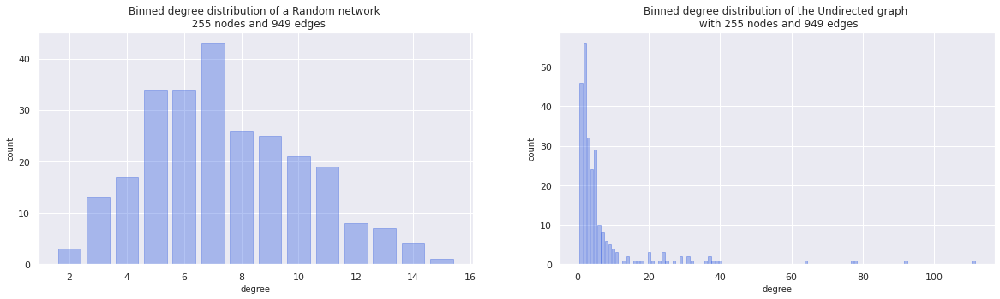

In [37]:
total_gu_nodes = len(G_undirected.nodes()) # compute the number of nodes in the undirected graph
total_gu_links = len(G_undirected.edges()) # compute the number of edges/links in the undirected graph

# Generate a random graph with the same number of nodes and edges (same probability of connection)
random_G = nx.gnm_random_graph(n=total_gu_nodes, m=total_gu_links)

random_g_bins, random_g_bins_count = get_degree_distribution(list(dict(random_G.degree()).values()))
gu_bins, gu_bins_count = get_degree_distribution(list(dict(G_undirected.degree()).values()))

fig, (ax_0, ax_1) = plt.subplots(ncols=2, figsize=(20, 5))

ax_0.bar(random_g_bins, random_g_bins_count, width=.8, color='royalblue',alpha=0.4,edgecolor='royalblue')

ax_0.set_title(f'Binned degree distribution of a Random network \n  {total_gu_nodes} nodes and {total_gu_links} edges')
ax_0.set_xlabel("degree", fontsize=10)
ax_0.set_ylabel("count", fontsize=10)

ax_1.bar(gu_bins, gu_bins_count, color='royalblue',alpha=0.4,edgecolor='royalblue')
ax_1.set_title(f'Binned degree distribution of the Undirected graph \n with {total_gu_nodes} nodes and {total_gu_links} edges')
ax_1.set_xlabel("degree", fontsize=10)
ax_1.set_ylabel("count", fontsize=10)

plt.show()

### Visualization

**Next we create a nice visualization of the total (undirected) network:** 
We use the following formatting:
>   * Set the nodes icon to be the characters thumbnail
>   * Get node positions based on the spring_layout;

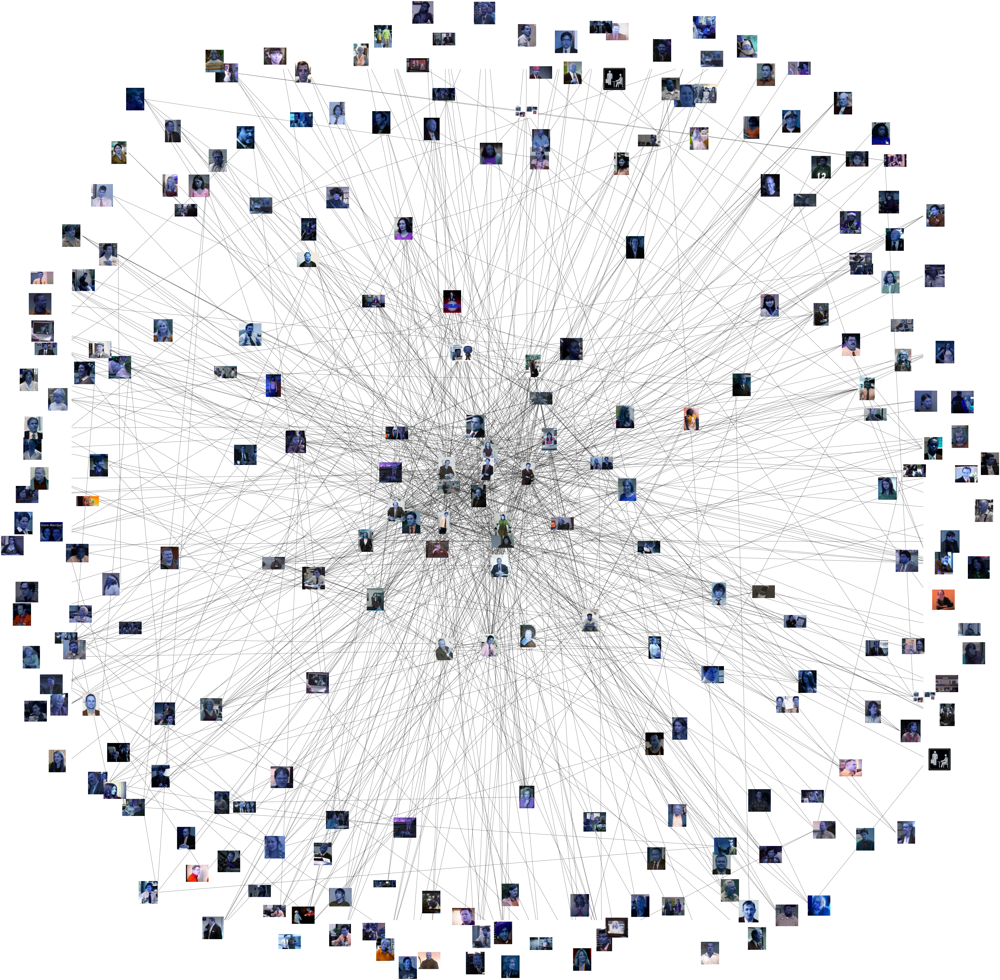

In [38]:
pos = nx.spring_layout(G_undirected, k = 0.5, iterations=20, scale=1.7) 
fig = plt.figure( figsize = (100, 100))
ax = plt.subplot(111)
ax.set_aspect('equal')
nx.draw_networkx_edges(G_undirected, pos, ax=ax)

plt.xlim(-1.5, 1.5)
plt.ylim(-1.5, 1.5)

trans = ax.transData.transform
trans2 = fig.transFigure.inverted().transform

piesize = 0.02  # this is the image size
p2 = piesize / 2.0
for n in G_undirected.nodes:
    xx , yy = trans(pos[n]) # figure coordinates
    xa , ya = trans2((xx , yy)) # axes coordinates
    a  =  plt.axes([xa - p2 , ya - p2 , piesize, piesize])
    a.set_aspect('equal')
    try :
        img = cv2.imread("./data/thumbnails/" + G_undirected.nodes[n]['img'])
        a.imshow(img)    
    except Exception :
        print(n)
        continue
    a.axis ('off')
ax.axis ('off')
plt.savefig ("network.png")

# IMDb: The Office Episode Raitings

Next we further complement our data with the raitings from each episode of The Offie, for all the 9 seasons using IMDb:https://www.imdb.com/title/tt0386676/episodes/_ajax.


IMDb doesn't have official API, so have found the id of The Office in IMDb: tt0386676, next we query the data for each episode:

In [39]:
imdb_url =  "https://www.imdb.com/title/tt0386676/episodes/_ajax"
number_of_seasons = 9

We use the requests library instead of urllib3, and the python `BeautifulSoup` library, as we are making ajax requests.

We make one request for each of the 9 seasons. For each request we extract: the season raitings, episode titles, votes, episode air dates and episodes.

The result is a data set consisting of 6 attributes, namely: the season of the show, episode number for each rating, title for each episode, IMDb raiting, number of votes, and air date of the episode

In [40]:
def get_raitings_and_votes(soup):
    ratings = []
    votes = []
    episodes = []
    
    rating_divs = soup.findAll("div", {"class": "ipl-rating-widget"})
    
    for index, div in enumerate(rating_divs):
        episodes.append(index + 1)

        # Find IMDb rating
        rating_div_inner = div.findAll("div", {"ipl-rating-star small"})
        soup_inner_rating = rating_div_inner[0].findAll("span", {"ipl-rating-star__rating"})
        ratings.append(soup_inner_rating[0].string)

        # Find total votes
        soup_inner_votes = rating_div_inner[0].findAll("span", {"ipl-rating-star__total-votes"})
        votes_string = soup_inner_votes[0].string
        votes_string = votes_string.replace(',', '')
        votes_string = votes_string.replace('(', '')
        votes_string = votes_string.replace(')', '')
        votes.append(int(votes_string))
        
    return episodes, ratings, votes

In [41]:
def get_episode_titles(soup):
    titles = []
    title_divs = soup.findAll("strong")
        
    for div in title_divs:
        titles.append(div.string) 
        
    #Popping the extra title (eg Season 1, Season 2, etcc) at end for each season (not required)
    titles.pop()
    
    return titles

In [42]:
def get_airdates(soup):
    airdates = []
    
    airdate_divs = soup.findAll("div", {"class": "airdate"})
    for div in airdate_divs:
        airdate_string = div.string
        airdate_string = airdate_string.replace('.', '')
        airdate_string = airdate_string.strip()
        airdates.append(airdate_string)
        
    return airdates

In [43]:
def get_episodes_description(soup):
    desciptions = []
    
    description_divs = soup.findAll("div", {"class": "item_description"})

    for description in description_divs:
        description_string = description.string.strip()
        desciptions.append(description_string)
    
    return desciptions

In [185]:
imdb_df = pd.DataFrame([])

for season in range(1, number_of_seasons + 1):
    print(f'Finding IMDb data for season {season}...')

    r = requests.get(url = imdb_url, params = {'season': season})
    
    # URL response is in HTML format
    soup = BeautifulSoup(r.content, 'html.parser')
    
    episodes, ratings, votes = get_raitings_and_votes(soup)
    titles = get_episode_titles(soup)
    airdates = get_airdates(soup)
    descriptions = get_episodes_description(soup)

    number_of_ep = len(ratings)
    seasons = [season] * number_of_ep
    
    # Preparing data for current season    
    data = {'Season': seasons, 'Episode': episodes, 'EpisodeTitle': titles, 'IMDBRating': ratings, 'TotalVotes': votes, 'AirDate': airdates, 'Description': descriptions}
    imdb_season_df = pd.DataFrame(data)
    imdb_df = imdb_df.append(imdb_season_df)

Finding IMDb data for season 1...
Finding IMDb data for season 2...
Finding IMDb data for season 3...
Finding IMDb data for season 4...
Finding IMDb data for season 5...
Finding IMDb data for season 6...
Finding IMDb data for season 7...
Finding IMDb data for season 8...
Finding IMDb data for season 9...


Next we examine the IMDb dataframe and we save it to csv:

In [45]:
imdb_df.head()

,Season,Episode,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description
0,1,1,Pilot,7.4,7116,24 Mar 2005,The premiere episode introduces the boss and s...
1,1,2,Diversity Day,8.3,7011,16 Mar 2005,Michael's off color remark puts a sensitivity ...
2,1,3,Health Care,7.7,5846,5 Apr 2005,Michael leaves Dwight in charge of picking the...
3,1,4,The Alliance,8.0,5660,12 Apr 2005,"Just for a laugh, Jim agrees to an alliance wi..."
4,1,5,Basketball,8.4,6283,19 Apr 2005,Michael and his staff challenge the warehouse ...


We further extend this data with the guest starts, directors and writers that we get from Kaggle:

# Kaggle dataset: The Office Dataset



 We extract the data from an existing Kaggle dataset and we load it into a dataframe by extracting the following columns: GuestStarts, Director, Writers. 

In [46]:
api = KaggleApi()
api.authenticate()

api.dataset_download_file('nehaprabhavalkar/the-office-dataset','the_office_series.csv', path='./data/kaggle_data')

False

In [47]:
office_df = pd.read_csv('data/kaggle_data/the_office_series.csv', usecols=['Season', 'EpisodeTitle', 'GuestStars', 'Director', 'Writers', 'Viewership'])
office_df['Writers'] = office_df['Writers'].str.split('|') 
office_df.head()

,Season,EpisodeTitle,Viewership,GuestStars,Director,Writers
0,1,Pilot,11.2,NaN,Ken Kwapis,"[Ricky Gervais , Stephen Merchant and Greg Dan..."
1,1,Diversity Day,6.0,NaN,Ken Kwapis,[B. J. Novak]
2,1,Health Care,5.8,NaN,Ken Whittingham,[Paul Lieberstein]
3,1,The Alliance,5.4,NaN,Bryan Gordon,[Michael Schur]
4,1,Basketball,5.0,NaN,Greg Daniels,[Greg Daniels]


In [48]:
office_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 188 entries, 0 to 187
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Season        188 non-null    int64  
 1   EpisodeTitle  188 non-null    object 
 2   Viewership    188 non-null    float64
 3   GuestStars    29 non-null     object 
 4   Director      188 non-null    object 
 5   Writers       188 non-null    object 
dtypes: float64(1), int64(1), object(4)
memory usage: 8.9+ KB


Now we merge this data set with the IMDb data about raitings. This data set will be used in the future for analysis.

In [186]:
imdb_df = imdb_df.merge(office_df, on=['Season', 'EpisodeTitle'], how='left')
imdb_df["IMDBRating"] = pd.to_numeric(imdb_df["IMDBRating"], downcast="float")

imdb_df.head()

,Season,Episode,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description,Viewership,GuestStars,Director,Writers
0,1,1,Pilot,7.4,7116,24 Mar 2005,The premiere episode introduces the boss and s...,11.2,NaN,Ken Kwapis,"[Ricky Gervais , Stephen Merchant and Greg Dan..."
1,1,2,Diversity Day,8.3,7011,16 Mar 2005,Michael's off color remark puts a sensitivity ...,6.0,NaN,Ken Kwapis,[B. J. Novak]
2,1,3,Health Care,7.7,5846,5 Apr 2005,Michael leaves Dwight in charge of picking the...,5.8,NaN,Ken Whittingham,[Paul Lieberstein]
3,1,4,The Alliance,8.0,5660,12 Apr 2005,"Just for a laugh, Jim agrees to an alliance wi...",5.4,NaN,Bryan Gordon,[Michael Schur]
4,1,5,Basketball,8.4,6283,19 Apr 2005,Michael and his staff challenge the warehouse ...,5.0,NaN,Greg Daniels,[Greg Daniels]


Since we want to analyse the impact of Guest stars in the season ratings, we will count the number of guest in every episode:

In [187]:
def count_guest_starts(guest_starts):
    if guest_starts == "nan":
        return 0
    else:
        return len(guest_starts.split(','))

imdb_df['Number of Guest Stars'] = imdb_df['GuestStars'].apply(lambda x: count_guest_starts(str(x)))

In [51]:
imdb_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 188 entries, 0 to 187
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Season                 188 non-null    int64  
 1   Episode                188 non-null    int64  
 2   EpisodeTitle           188 non-null    object 
 3   IMDBRating             188 non-null    float32
 4   TotalVotes             188 non-null    int64  
 5   AirDate                188 non-null    object 
 6   Description            188 non-null    object 
 7   Viewership             188 non-null    float64
 8   GuestStars             29 non-null     object 
 9   Director               188 non-null    object 
 10  Writers                188 non-null    object 
 11  Number of Guest Stars  188 non-null    int64  
dtypes: float32(1), float64(1), int64(4), object(6)
memory usage: 18.4+ KB


In [188]:
imdb_df.to_csv("data/imdb_ratings.csv")

To better understand the data we are analysising, we will do some basic statistics with the transcripts dataframe.

#### Number of episodes in every season

We start by looking at the episodes per season. This will be useful when doing sentiment and word-cloud analysis of every season. 

In [53]:
episodes_per_season = list(imdb_df.groupby(by='Season').count()['Episode'])
seasons = list(imdb_df.Season.unique())
episodes_per_season

[6, 22, 23, 14, 26, 26, 24, 24, 23]

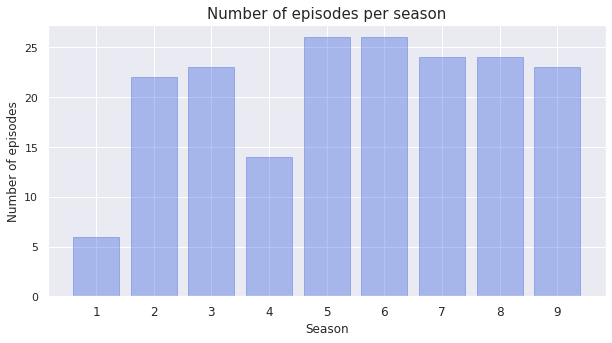

In [54]:
fig = plt.figure(figsize=(10, 5))
plt.bar(seasons, episodes_per_season, color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xticks(seasons, fontsize=12)   #rotate so that Harry (Breath of the Wild) fits among others.
plt.xlabel('Season', fontsize=12)
plt.ylabel('Number of episodes', fontsize=12)
plt.title("Number of episodes per season", fontsize=15)
plt.show()

Season 1 had only 6 episodes. After this, the seasons tend to have between 22 and 26 episodes, except for season 4, which has onlt 14 apidoes. The longest seasons, on the other hand, were season 5 and 6, with 26 episodes each. 

#### Season Viewership

Analyse how the views have changed from season to season.

In [55]:
viewership_seasons = imdb_df.groupby(['Season'])['Viewership'].mean()

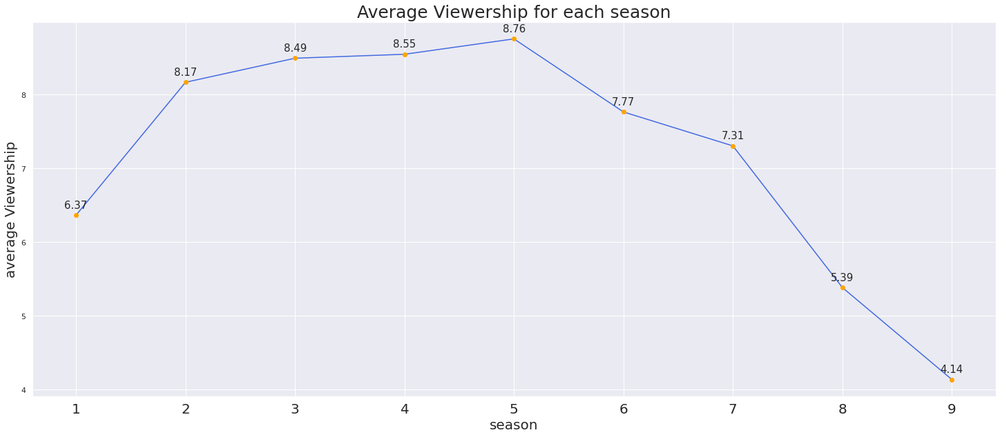

In [56]:
fig, ax = plt.subplots(figsize=(25,10))

ax.plot(seasons, viewership_seasons, color='royalblue')
plt.plot(seasons, viewership_seasons, 'o',  color='orange')

plt.xticks(seasons, fontsize=20)   #rotate so that Harry (Breath of the Wild) fits among others.

ax.set_xlabel('season', fontsize=20)
ax.set_ylabel('average Viewership', fontsize=20)
ax.set_title('Average Viewership for each season', fontsize=25)

add_y_values_to_plot(seasons, viewership_seasons)

plt.show()

The average Viewership has a consistent growth until season 5. After season 5, there is a steady decline in the views. The most signficant decline of views is from season 7 to season 8, after Michael left. 

#### Top 10 highest rated episodes

Next, we look at the 10 episodes that obtained the highest ratings using the `IMDBRating` and `TotalVotes` columns from the IMBD data.

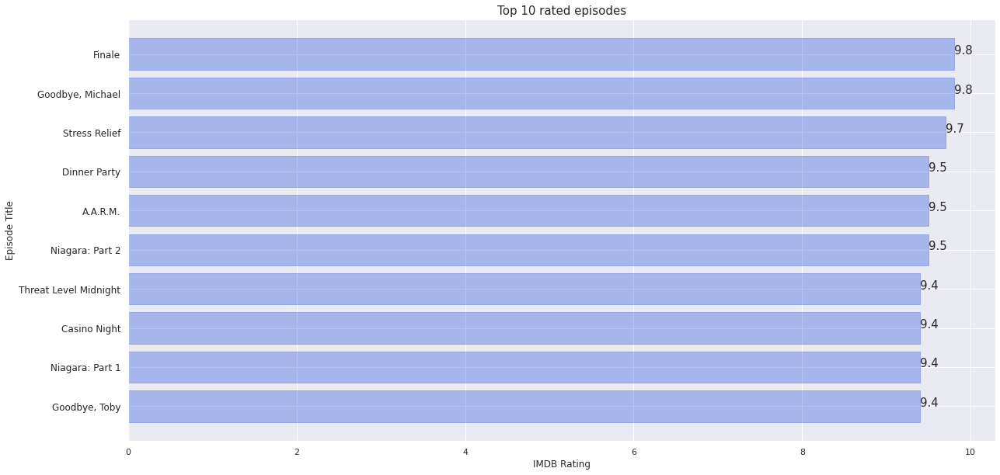

In [57]:
fig = plt.figure(figsize=(20, 10))
top_10_rated = imdb_df.sort_values(by=['IMDBRating', 'TotalVotes']).iloc[-10:,:]
plt.barh(top_10_rated['EpisodeTitle'], top_10_rated['IMDBRating'], color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.yticks(top_10_rated['EpisodeTitle'], fontsize=12)   #rotate so that Harry (Breath of the Wild) fits among others.
plt.xlabel('IMDB Rating', fontsize=12)
plt.ylabel('Episode Title', fontsize=12)
plt.title("Top 10 rated episodes", fontsize=15)

for index, value in enumerate(top_10_rated['IMDBRating']):
    value = round(value, 2)
    plt.text(value, index, str(value))
plt.show()
    

The highest rated episodes are the Final episode, and Goodbey, Michael, in season 7, when michael leaves The Office. Both are rated with 9.8

#### 10 most viewed episodes

Next, we look at the 10 most viewed episodes using the `Viewership` column. 

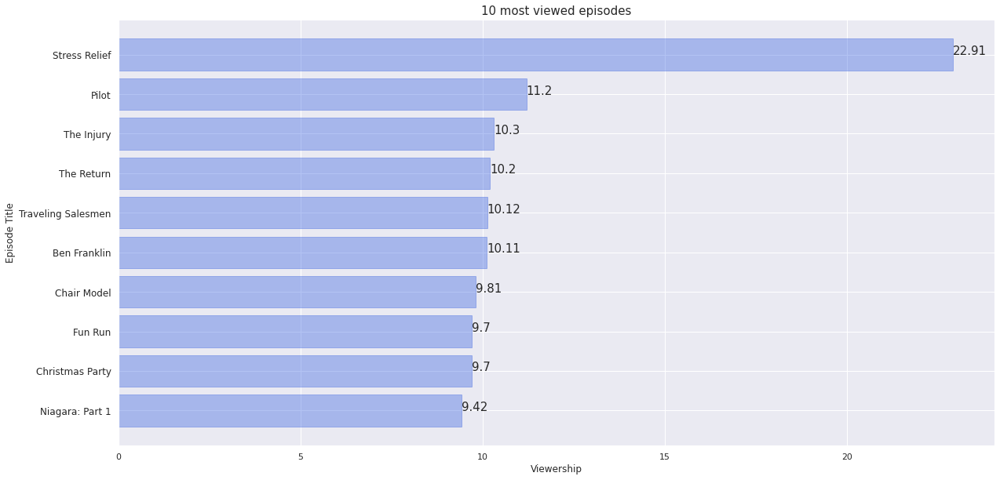

In [58]:
fig = plt.figure(figsize=(20, 10))
most_viewed = imdb_df.sort_values(by=['Viewership']).iloc[-10:,:]
plt.barh(most_viewed['EpisodeTitle'], most_viewed['Viewership'], color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.yticks(most_viewed['EpisodeTitle'], fontsize=12)   #rotate so that Harry (Breath of the Wild) fits among others.
plt.xlabel('Viewership', fontsize=12)
plt.ylabel('Episode Title', fontsize=12)
plt.title("10 most viewed episodes", fontsize=15)

for index, value in enumerate(most_viewed['Viewership']):
    value = round(value, 2)
    plt.text(value, index, str(value))
plt.show()
    

We can see that there are some similiarities in the most viewed and top rated episodes. Stress Relief is the most viewed episode of all seasons, and at the same time is the 3rd top rated episode. Then, Christmas Party and Niagara: Part 1, are both in the top 10 most viewed and top 10 rated episodes.

#### Season Raiting

We want to analyse how the ratings changed from season to season. This will later be used when analizing the character sentiments, and their transcripts.

In [59]:
rating_seasons = imdb_df.groupby(['Season'])['IMDBRating'].mean()

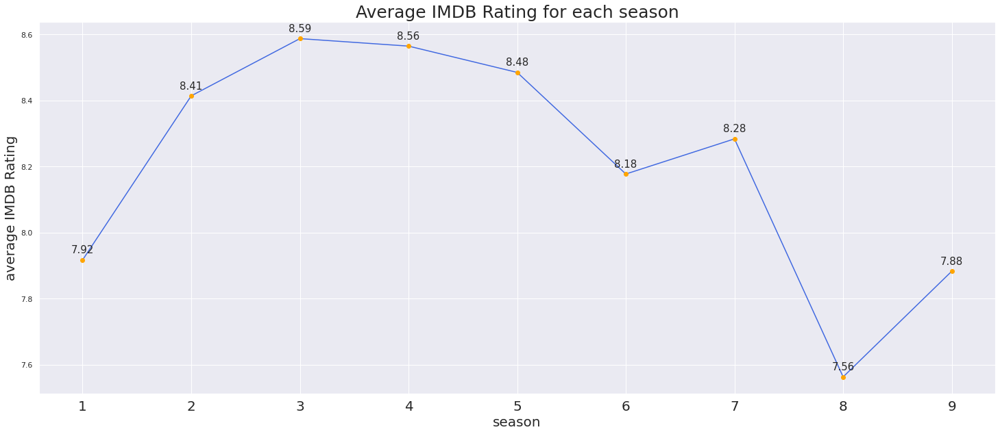

In [60]:
fig, ax = plt.subplots(figsize=(25,10))

ax.plot(seasons, rating_seasons, color='royalblue')
plt.plot(seasons, rating_seasons, 'o',  color='orange')

plt.xticks(seasons, fontsize=20)   #rotate so that Harry (Breath of the Wild) fits among others.

ax.set_xlabel('season', fontsize=20)
ax.set_ylabel('average IMDB Rating', fontsize=20)
ax.set_title('Average IMDB Rating for each season', fontsize=25)

add_y_values_to_plot(seasons,rating_seasons)

plt.show()

We can see that there is an exponential rating growth from season 1 to 5. However, seasons 5 and 6 had a lower rating. And after Michael left, the ratings highly decreased, specially in season 8. We will see if the transcripts can explain this data.

#### Episode Rating

The season rating analysis showed that the best rated seasons were 2, 3, 4 and 5, with a huge decrease after Michael left in the last episode of season 7. Now, we are going to perform a more detailed analysis by considering the IMDb rating for all the episodes in the Office. 

In [253]:
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(
        x = imdb_df.AirDate,
        y = imdb_df.IMDBRating,
        name = "IMDB Rating"))

fig.add_trace(
    go.Bar(
        x = imdb_df.AirDate,
        y = imdb_df.TotalVotes,
        name = "Votes",
        marker_color='rgba(0, 0, 100,0.2)'),
    secondary_y=True)


fig.add_annotation(x="28 Apr 2011", y=9.8,
            text="Good bye, Michael episode",
            showarrow=True,
            arrowhead=1)

fig.update_layout(
    title = 'IMDB Ratings and Votes for all episode',
    xaxis_title="Air Date",
    xaxis=dict(
        showline=True,
        showgrid=True,
        showticklabels=True,
        linecolor='rgb(204, 204, 204)',
        linewidth=2,
        ticks='outside'
    ),
    yaxis=dict(
        showgrid=True,
        zeroline=True,
        showline=True,
        showticklabels=True,
        gridcolor='rgba(0, 0, 0,0.09)'
    ),
   
    plot_bgcolor='white'
)

fig.update_xaxes(nticks=10)
fig.update_yaxes(title_text="IMDB Rating", secondary_y=False)
fig.update_yaxes(title_text="Votes", secondary_y=True)
fig.show()


The above plot offers a more clear representation of what we previously observed. The episodes until Good bye, Michael in season 7, obtain relatively high ratings. However, after Michael leaves, the episode rating is never as high as it was in previous seasons, until the last episode of season 9 'Finale', where Michael comes back.

The number of votes received is more or less the same throught all the episodes, and those episodes with high ratings obtain always high votes. However, all other episodes with rarings around or below 7, obtain around 4000-5000 votes on average.

#### Guest starts in every season

From time to time, guest stars appear in an episode. We would like to study if there is a relation between the number of guest stars that appear in a season, and the season rating. For this, first we look into the guest stars distribution:

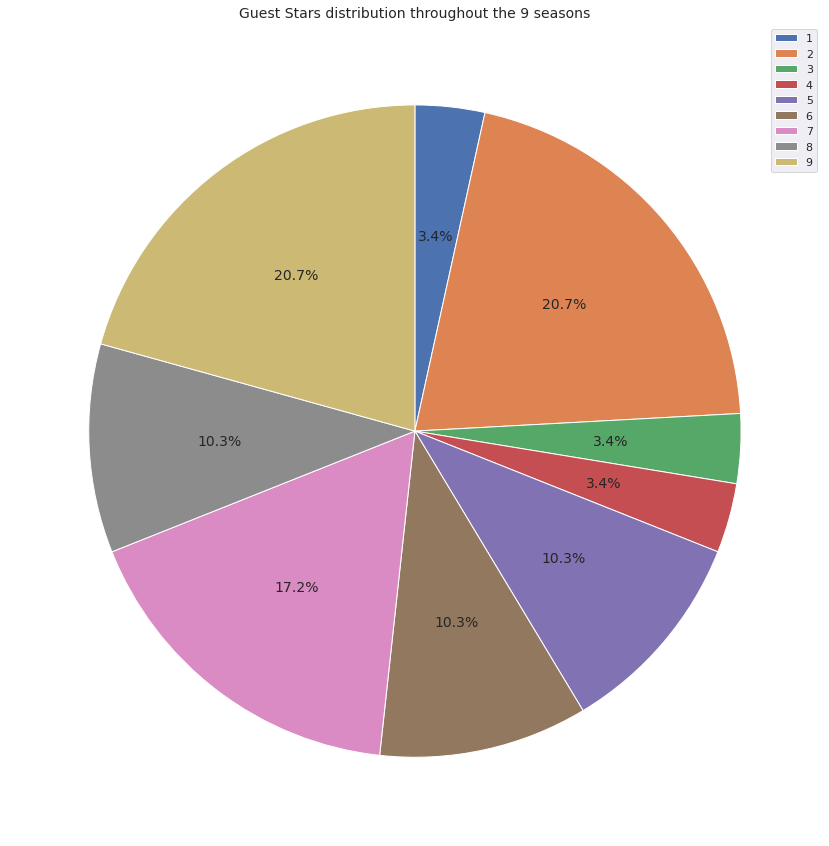

In [61]:
guest_starts = imdb_df.groupby(['Season'])['GuestStars'].count().to_dict()
fig = plt.figure(figsize=(15,15))
plt.pie(guest_starts.values(), startangle=90, counterclock=False,
        autopct='%.1f%%', textprops={'fontsize':14})
plt.title("Guest Stars distribution throughout the 9 seasons", fontsize=14)
plt.legend(guest_starts, loc="best")
plt.show()

We can see that the number of Guest stars starts very low in the first season, but drastically grows in Season 2 to $20.7\%$. However, the number descreases again in seasons 3 and 4. Then it grows constantly during season 5 to 8 from $10.3\%$ and a maximum of $17.2\%$ in season 7. In the last season, the number of guest starts grows again to be the same as in season 2, $20.7\%$. 

Based on these statistics, we will later examine if the number of guest starts has an effect on the raiting of the seasons and the top rated episodes.

#### Influence of Guest starts in season ratings.

Now we are going to put everything together. First, we start by looking if the number of guest stars had an influence in the ratings for all the 9 seasons:

In [62]:
fig = px.box(imdb_df, y ='IMDBRating', x ='Number of Guest Stars', color='Number of Guest Stars', 
             title='Ratings Distribution based on the Number of Guest Stars')
fig.update_layout(showlegend = False)
fig.show()

Episodes with a greater number of Guest Stars have higher raiting. As it can be seen from the above box plot, the median IMDb raiting is 9.15 when there were 4 guess stars, but only 8.2 when no guest stars appeared in the episode. This could explain why there was an increase in the number of stars in season 9. The producers could have thought that including more guest stars could increase the ratings of the season after the low ratings of season 8. 

#### Influence of the Guest stars in the season views. 

We could see that there seems to be a relation between the season's ratings and the guest stars that appear in the season. We further look into the guest stars influence in the seasons popularity by contrasting the number of  guest stars with the season's views.

In [63]:
fig = px.box(imdb_df, y ='Viewership', x ='Number of Guest Stars', color='Number of Guest Stars', 
             title='Viewership Distribution based on the Number of Guest Stars')
fig.update_layout(showlegend = False)
fig.show()

Episodes with one guess star have a higher median rating that those with 0 guess stars. However, as the number of guess stars increases, the views do not neccessarily increse. The average viewership with 4 guess stars in an episode is less than those with one guess star. 

Hence, the guess stars influence the ratings but do not necessarily influence the views.

#### Writers influence on the episode ratings

Throught the 9 seasons, episodes have been written by different people. Sometimes even by actors themselves. Let's look at the different writers aand the number of episodes they have writen.

In [64]:
office_writters_episode_count = imdb_df.groupby(imdb_df['Writers'].map(tuple))['EpisodeTitle'].count().to_dict()
sorted_office_writters_episode_count = {writter[0]: episode_count \
                                        for writter, episode_count in sorted(office_writters_episode_count.items(),
                                                                             reverse=True, key=lambda item: item[1])}

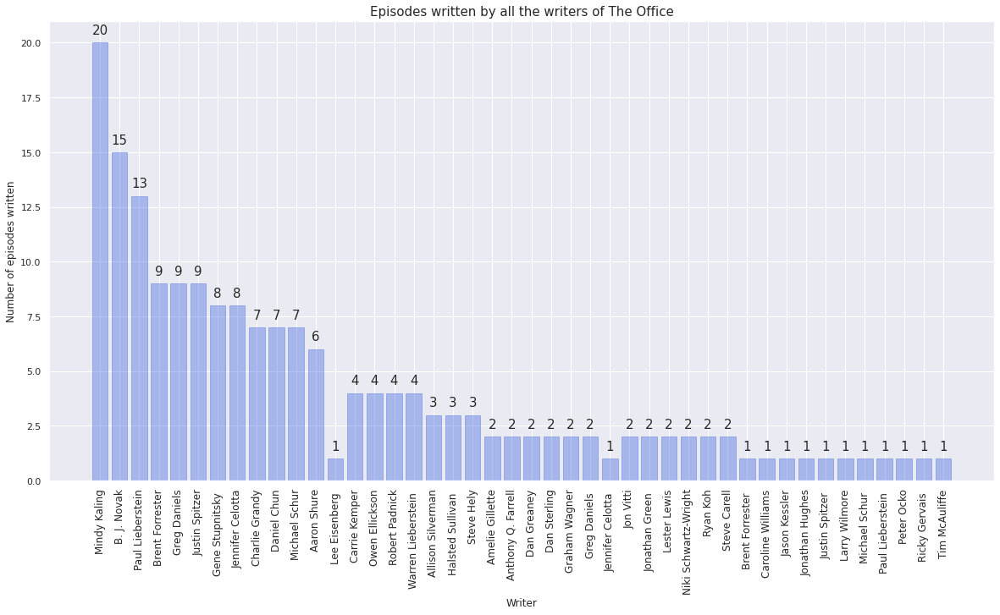

In [65]:
fig = plt.figure(figsize=(20, 10))
plt.bar(list(sorted_office_writters_episode_count.keys()), sorted_office_writters_episode_count.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xticks(list(sorted_office_writters_episode_count.keys()), rotation=90, fontsize=12)   #rotate so that Harry (Breath of the Wild) fits among others.
plt.xlabel('Writer', fontsize=12)
plt.ylabel('Number of episodes written', fontsize=12)
plt.title("Episodes written by all the writers of The Office", fontsize=15)

add_y_values_to_plot(sorted_office_writters_episode_count.keys(), sorted_office_writters_episode_count.values(), False)

plt.show()


The three writers who have written the most episodes along the nine seasons are in fact 3 of the main characters of The Office. 

<table><tr>
<td>Mindy Kaling (Kelly)<img src="imgs/Mindy-Kaling.jpg" width=300 height=300 /></td>
<td>B.J.Novak (Ryan)<img src="imgs/BJNovak.png"width=180 height=200/> </td>
<td>Paul Lieberstein (Toby)<img src="imgs/Paul-Lieberstein.jpg"width=250 height=200/> </td>
</tr></table>

Kelly has written 20 episodes, Ryan 15 and Toby 13. 

Let's now look into how the episodes writen by these characters are rated according to IMDb:

In [66]:
writer_avg_rating = imdb_df.groupby(imdb_df['Writers'].map(tuple))['IMDBRating'].mean().to_dict()
sorted_writer_avg_rating = {writter[0]: episode_count \
                                        for writter, episode_count in sorted(writer_avg_rating.items(),
                                                                             reverse=True, key=lambda item: item[1])}

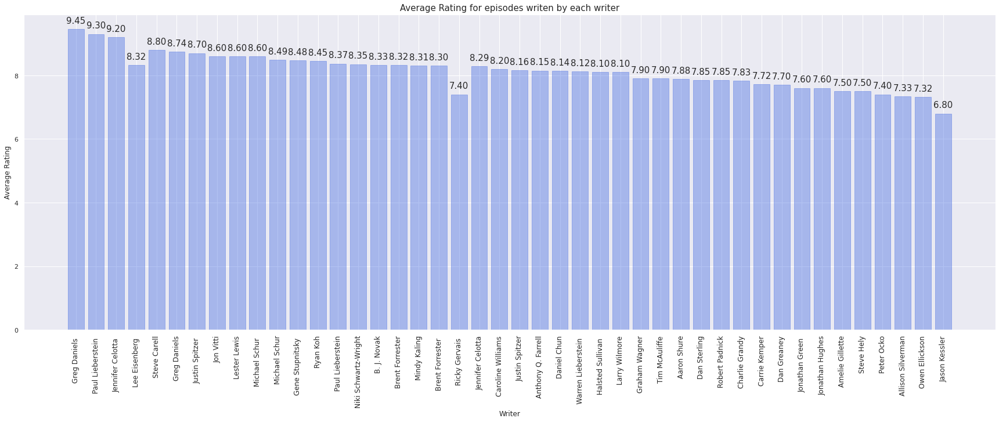

In [67]:
fig = plt.figure(figsize=(30, 10))
plt.bar(list(sorted_writer_avg_rating.keys()), sorted_writer_avg_rating.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xticks(list(sorted_writer_avg_rating.keys()), rotation=90, fontsize=12) 
plt.xlabel('Writer', fontsize=12)
plt.ylabel('Average Rating', fontsize=12)
plt.title("Average Rating for episodes writen by each writer", fontsize=15)

add_y_values_to_plot(sorted_writer_avg_rating.keys(), sorted_writer_avg_rating.values())

plt.show()

The episodes written by Greg Daniels, an american screenwriter, are the top rated episodes. However, in second place we can find the episodes writen by Paul Lieberstein, the actor Toby in the series. This shows that he is not only a good actor, but also a talented writer. His episodes are averaged rated with 9.3/10. 

The episodes written by Ryan and Kelly are rated with 8.33 and 8.31, respectively. One point difference from Toby's episodes. 

Hence, Kelly (Mindy Kaling) and Toby (Paul Liberstein) are the top two writers in terms of the number of episodes they have written.

#### Director influence on the episode ratings

Similarly to the above analysis, the episodes have been directed by different people, also including the actors themselves.

In [68]:
director_episode_count = imdb_df.groupby('Director')['EpisodeTitle'].count().to_dict()
sorted_director_episode_count = {director: episode_count \
                                        for director, episode_count in sorted(director_episode_count.items(),
                                                                             reverse=False, key=lambda item: item[1])}

In [69]:
director_avg_rating = imdb_df.groupby('Director')['IMDBRating'].mean().to_dict()
sorted_director_avg_rating = {director: episode_count \
                                        for director, episode_count in sorted(director_avg_rating.items(),
                                                                             reverse=False, key=lambda item: item[1])}

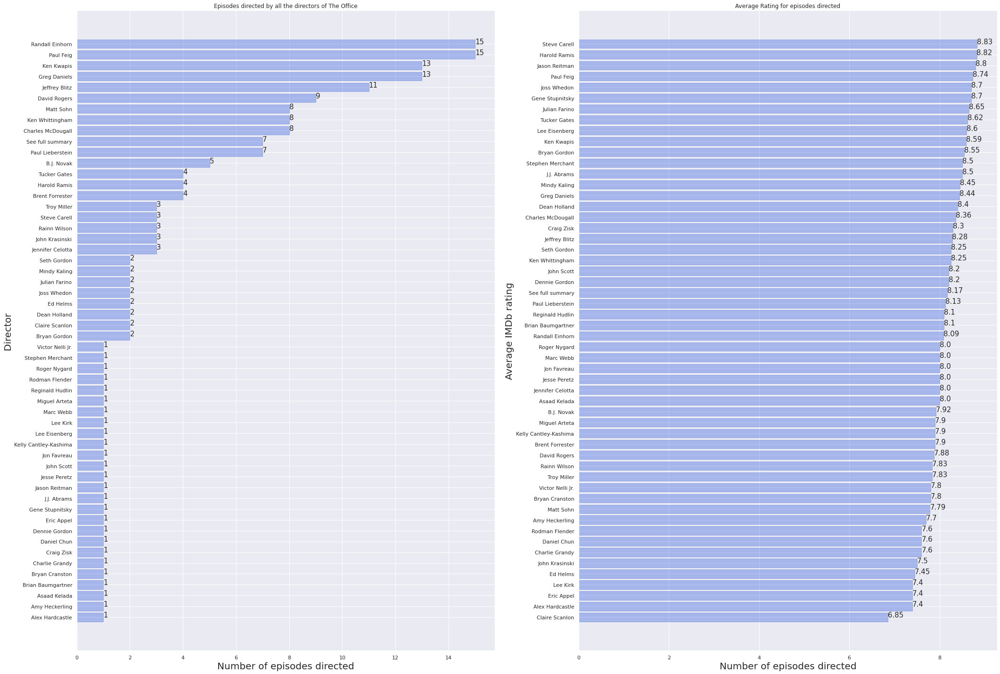

In [70]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(35, 25))

ax[0].barh(list(sorted_director_episode_count.keys()), sorted_director_episode_count.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')

ax[0].set_title('Episodes directed by all the directors of The Office')
ax[0].set_ylabel("Director", fontsize=20)
ax[0].set_xlabel("Number of episodes directed", fontsize=20)

for index, value in enumerate(sorted_director_episode_count.values()):
    ax[0].text(value, index, str(value))
    
# we use bar and scatter plots of the same distributions for better visualization purposes
ax[1].barh(list(sorted_director_avg_rating.keys()), sorted_director_avg_rating.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
ax[1].set_title('Average Rating for episodes directed')
ax[1].set_xlabel("Number of episodes directed", fontsize=20)
ax[1].set_ylabel("Average IMDb rating", fontsize=20)

for index, value in enumerate(sorted_director_avg_rating.values()):
    value = round(value, 2)
    ax[1].text(value, index, str(value))

Let's peek into the top 10 rated episodes previously found to be able to draw conclusions on the director ratings:

In [71]:
top_10_rated

,Season,Episode,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description,Viewership,GuestStars,Director,Writers,Number of Guest Stars
64,4,14,"Goodbye, Toby",9.4,5668,15 May 2008,Michael throws an extravagant going-away party...,8.07,NaN,Paul Feig,"[Jennifer Celotta , Paul Lieberstein]",0
94,6,4,Niagara: Part 1,9.4,6347,8 Oct 2009,The Office travels to Niagara Falls to celebra...,9.42,NaN,Paul Feig,"[Greg Daniels , Mindy Kaling]",0
27,2,22,Casino Night,9.4,6792,11 May 2006,The Dunder Mifflin crew holds a casino party a...,7.60,NaN,Ken Kwapis,[Steve Carell],0
132,7,16,Threat Level Midnight,9.4,7369,17 Feb 2011,"Michael finally finishes his movie ""Threat Lev...",6.41,NaN,Tucker Gates,[B. J. Novak],0
95,6,5,Niagara: Part 2,9.5,5212,8 Oct 2009,Pam is forced to deal with an embarrassing inj...,9.42,NaN,Paul Feig,"[Greg Daniels , Mindy Kaling]",0
186,9,22,A.A.R.M.,9.5,6018,9 May 2013,Dwight prepares for a marriage proposal and hi...,4.56,NaN,David Rogers,[Brent Forrester],0
59,4,9,Dinner Party,9.5,8358,10 Apr 2008,Michael invites Jim and Pam and Andy and Angel...,9.22,NaN,Paul Feig,"[Gene Stupnitsky , Lee Eisenberg]",0
77,5,13,Stress Relief,9.7,12094,1 Feb 2009,Dwight's too-realistic fire alarm gives Stanle...,22.91,"Cloris Leachman, Jack Black, Jessica Alba",Jeffrey Blitz,[Paul Lieberstein],3
137,7,21,"Goodbye, Michael",9.8,12450,28 Apr 2011,As the office gets ready for Michael's final d...,8.42,NaN,Paul Feig,[Greg Daniels],0
187,9,23,Finale,9.8,15461,16 May 2013,"One year later, Dunder Mifflin employees past ...",5.69,"Joan Cusack, Ed Begley Jr, Rachel Harris, Nanc...",Ken Kwapis,[Greg Daniels],4


Randall Einhorn and Paul Feig have directed the most number of episodes. At the same time, looking at the top 10 rated episodes we can see that Paul has directed 5 out of the top most rated episodes: Goodbye Michael, Goodbye Toby, Niagara:Part 1 and 2 and Dinner party. However, Randall has not directed any of the top 10 rated episodes.

On the other hand, Steve Carell, who plays as Michael, has the highest Average Rating for all his directed episodes. Although he has only directed 3 episodes.

Once again, a few actors of the cast have also been involved in directing episodes. Let's look at their raitings individually: 


In [72]:
cast_directors = ['Paul Lieberstein', 'B.J. Novak','Steve Carell', 'John Krasinski','Rainn Wilson','Mindy Kaling']
cast_director_episode_count = dict(filter(lambda x: x[0] in cast_directors, sorted_director_episode_count.items()))
cast_director_avg_rating = dict(filter(lambda x: x[0] in cast_directors, sorted_director_avg_rating.items()))

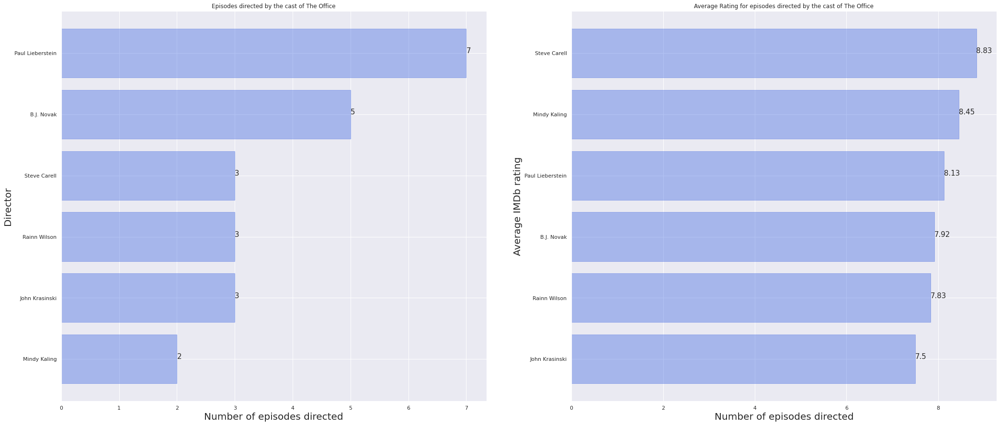

In [73]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(35, 15))

ax[0].barh(list(cast_director_episode_count.keys()), cast_director_episode_count.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')

ax[0].set_title('Episodes directed by the cast of The Office')
ax[0].set_ylabel("Director", fontsize=20)
ax[0].set_xlabel("Number of episodes directed", fontsize=20)

for index, value in enumerate(cast_director_episode_count.values()):
    ax[0].text(value, index, str(value))
    
# we use bar and scatter plots of the same distributions for better visualization purposes
ax[1].barh(list(cast_director_avg_rating.keys()), cast_director_avg_rating.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
ax[1].set_title('Average Rating for episodes directed by the cast of The Office')
ax[1].set_xlabel("Number of episodes directed", fontsize=20)
ax[1].set_ylabel("Average IMDb rating", fontsize=20)

for index, value in enumerate(cast_director_avg_rating.values()):
    value = round(value, 2)
    ax[1].text(value, index, str(value))

Steve Carell, Michael, has the highest average rating for the 3 episodes he has directed, followed by Mindy Kaling, Kelly, who has directed 2 episodes. 

Out of the 6 actors who directed episodes, the worst performing ones were the ones directed by John Krasinski, Jim, who directed 3 episodes. 

Paul Lieberstein and B.J.Novak are the ones who have been involved the most in the directing and writing of episodes. They have directed 7 and 5 episodes, respectively. And they have written 15 and 13 episodes, respectively. We can conclude however, that Paul Lieberstein is better at writing episodes, than at directing them.

 # Kaggle dataset: The Office (US) - Complete Dialogue/Transcript

We extract the data from an existing Kaggle dataset and we load it into a dataframe to do exploratory data analysis:

In [74]:
api = KaggleApi()
api.authenticate()

api.dataset_download_file('nasirkhalid24/the-office-us-complete-dialoguetranscript','The-Office-Lines-V4.csv', path='./data/kaggle_data')
with zipfile.ZipFile('./data/kaggle_data/The-Office-Lines-V4.csv.zip', 'r') as zip_ref:
    zip_ref.extractall('./data')

In [75]:
transcripts_df = pd.read_csv('data/The-Office-Lines-V4.csv')
transcripts_df = transcripts_df.drop('Unnamed: 6', axis=1)

transcripts_df.head()

,season,episode,title,scene,speaker,line
0,1,1,Pilot,1,Michael,All right Jim. Your quarterlies look very good...
1,1,1,Pilot,1,Jim,"Oh, I told you. I couldn't close it. So..."
2,1,1,Pilot,1,Michael,So you've come to the master for guidance? Is ...
3,1,1,Pilot,1,Jim,"Actually, you called me in here, but yeah."
4,1,1,Pilot,1,Michael,"All right. Well, let me show you how it's done."


Looking at the data, we can see that the speaker includes only the name of the character, and not the surname. Since the Dunderpedia data includes the character surnames, we will modify the `transcripts_df` speaker column to also include the surnames. This will later be useful in the analysis.

In [76]:
transcripts_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54626 entries, 0 to 54625
Data columns (total 6 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   season   54626 non-null  int64 
 1   episode  54626 non-null  int64 
 2   title    54626 non-null  object
 3   scene    54626 non-null  int64 
 4   speaker  54626 non-null  object
 5   line     54626 non-null  object
dtypes: int64(3), object(3)
memory usage: 2.5+ MB


The data downloaded consists of 54167 row and 6 attributes, namely: the season of the show, episode number for each dialogue, the character in the show saying the dialog and the line or dialogue the character says.

Next we make sure that our data does not contain missing values:

In [77]:
transcripts_df.isnull().sum()

season     0
episode    0
title      0
scene      0
speaker    0
line       0
dtype: int64

Looking at the data we could see that some lines are said by various speakers, in the format: `Jim & Pam`, `Dwight and Andy` or `Michael, Pam & Ryan`. For a more accurate analysis, we will separate these into different lines, one per speaker. 

In [78]:
transcripts_df.loc[transcripts_df['speaker'] == 'Michael, Pam & Ryan']

,season,episode,title,scene,speaker,line
24660,5,24,Heavy Competition,3908,"Michael, Pam & Ryan","U-G-L-Y, you ain't got no alibi! You ugly, huh..."


In [79]:
transcripts_df.loc[transcripts_df['speaker'] == 'Jim & Pam']

,season,episode,title,scene,speaker,line
29117,6,11,Shareholder Meeting,4477,Jim & Pam,No thanks.


In [80]:
transcripts_df.loc[transcripts_df['speaker'] == 'Dwight and Andy']

,season,episode,title,scene,speaker,line
24571,5,23,The Michael Scott Paper Company,3894,Dwight and Andy,"Take me home, country roads, to the place, I b..."
27785,6,6,Mafia,4291,Dwight and Andy,Oh man.


In [81]:
transcripts_df['speaker'].replace('and', ',', inplace=True, regex=True)
transcripts_df['speaker'].replace('&', ',', inplace=True, regex=True)

transcripts_df['speaker'] = transcripts_df['speaker'].str.split(',') # convert column to array

transcripts_df = transcripts_df.explode('speaker') # split array in multiple rows (one row per element)
transcripts_df['speaker'] = transcripts_df['speaker'].str.strip() # remove white spaces

transcripts_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 54815 entries, 0 to 54625
Data columns (total 6 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   season   54815 non-null  int64 
 1   episode  54815 non-null  int64 
 2   title    54815 non-null  object
 3   scene    54815 non-null  int64 
 4   speaker  54815 non-null  object
 5   line     54815 non-null  object
dtypes: int64(3), object(3)
memory usage: 2.9+ MB


Now we have 189 more rows than before, and all the lines are splited into individual speakers.

#### Main characters transcript analysis

We now extract the transcripts for the main characters, and group them by speaker and perform some exploratory analysis. 

In [82]:
main_characters = df.loc[df['Main Role'] == 'Main Characters']['Name']
main_character_names = list(map(lambda full_name: full_name.split(' ')[0], list(main_characters)))
print(f'The lead characters in The Office are: {main_character_names}')

The lead characters in The Office are: ['Andy', 'Angela', 'Clark', 'Creed', 'Darryl', 'Dwight', 'Erin', 'Gabe', 'Jan', 'Jim', 'Karen', 'Kelly', 'Kevin', 'Meredith', 'Michael', 'Nellie', 'Oscar', 'Pam', 'Pete', 'Phyllis', 'Robert', 'Roy', 'Ryan', 'Stanley', 'Toby']


In [83]:
main_character_transcripts_df = transcripts_df.query('speaker in @main_character_names') 

main_character_transcripts_df.head()

,season,episode,title,scene,speaker,line
0,1,1,Pilot,1,Michael,All right Jim. Your quarterlies look very good...
1,1,1,Pilot,1,Jim,"Oh, I told you. I couldn't close it. So..."
2,1,1,Pilot,1,Michael,So you've come to the master for guidance? Is ...
3,1,1,Pilot,1,Jim,"Actually, you called me in here, but yeah."
4,1,1,Pilot,1,Michael,"All right. Well, let me show you how it's done."


In [84]:
# create a dictionary, mapping each speaker to lines (said by that speaker)
transcripts_df_grouped = main_character_transcripts_df.groupby(by='speaker')['line'].apply(list).to_dict()

Let's now see how many lines the main characters have and in how this varies from season to season:

In [85]:
sorted_line_count = {character: len(lines) for character, lines in sorted(transcripts_df_grouped.items(), key=lambda item: len(item[1]))}

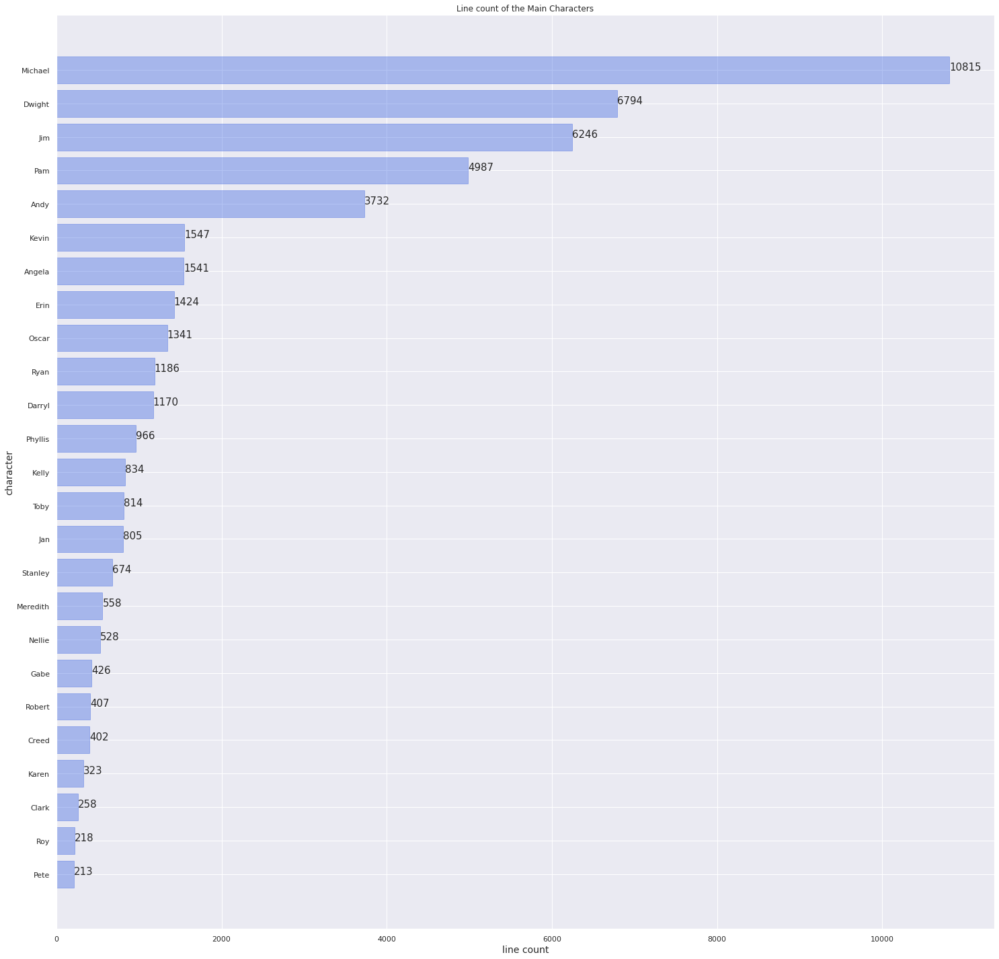

In [86]:
fig = plt.figure(figsize=(25, 25))
plt.barh(list(sorted_line_count.keys()), sorted_line_count.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xlabel('line count', fontsize=14)
plt.ylabel('character', fontsize=14)
plt.title('Line count of the Main Characters')

for index, value in enumerate(sorted_line_count.values()):
    plt.text(value, index, str(value))
    
plt.show()

Michael, the main character and Regional Manager of the Scranton branch is the character with the most lines, even though he left The Office in season 7, and hence did not participate in the last two seasons. Now, we will analyse the line count by season for each of the main characters, and see who is the main character after Michael left. 

In [87]:
fig = plt.figure(figsize=(120, 150))

for season, num in zip(main_character_transcripts_df['season'].unique(), range(1,10)):# loop through the keys of the wordcloud_strings dictionary (every race) 
    transcripts_df_grouped = main_character_transcripts_df. \
            loc[main_character_transcripts_df['season'] == season] \
            .groupby(by='speaker')['line'].apply(list).to_dict()
    
    sorted_line_count = {character: len(lines) for character, lines in sorted(transcripts_df_grouped.items(), key=lambda item: len(item[1]))}
    
    ax = fig.add_subplot(3,3, num)
    ax.barh(list(sorted_line_count.keys()), sorted_line_count.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
    ax.set_xlabel('line count', fontsize=62)
    ax.set_ylabel('character', fontsize=62)
    ax.set_title(f'Season {season}', fontsize=62)

    plt.xticks(fontsize=62)
    plt.yticks(fontsize=62)
    
plt.show()

We can see that Michael is the main character in all the 7 seasons where he participates. The second place is shared by Dwigth and Jim through the first 8 seasons. In season 8, Andy gets promoted to regional manager, to replace Michael, and hence, he is the character with the most lines in that season. However, in season 9, it is Dwight who gets promoted to regional manager. Hence, he is the dominant character with the most lines in that season. We can therefore see a pattern, the regional manager of the Scranton branch is always the character with the most lines.

This is related to the analysis done with the IMDB ratings. Season8, after Michael left, is rated as the worst season. This can also be influenced by the fact that Michael's replacement was Andy, who is known not to be liked by the audience. After season 8, Andy was replaced in the role of regional manager by Dwigth, and the ratings went up slightly. Can it be that the writers noticed that Andy was not liked by the audience? 

#### Top speaker influence in the episode raiting

We saw, on average, Michael is the top speaker for the 7 seasons where he participates. Now, we want to further investigate if there is a relation between the top speaker in every episode of every season, and that episode IMDb raiting. 

In order to achieve this, we create a new dataframe `top_speakers_df`, where we compute the top speaker for every episode of every season. The top speaker is calculated by summing up their lines during that episode. 

In [88]:
top_speakers = {'Season': [], 'Episode': [], 'Top speaker': []}

for season in imdb_df['Season'].unique():
    imdb_seasons = imdb_df.loc[imdb_df['Season'] == season]
    
    for episode in imdb_seasons['Episode'].unique():
        try:
            transcripts_df_grouped = main_character_transcripts_df[(main_character_transcripts_df['season'] == season) \
                        & (main_character_transcripts_df['episode'] == episode)] \
                .groupby(by='speaker')['line'].apply(list).to_dict()

            sorted_line_count = {character: len(lines) for character, lines in sorted(transcripts_df_grouped.items(), reverse=True, key=lambda item: len(item[1]))}
            top_speaker = list(sorted_line_count.keys())[0]

            top_speakers['Season'].append(season)
            top_speakers['Episode'].append(episode)
            top_speakers['Top speaker'].append(top_speaker)
        except: # the Kaggle dataset is missing lines for some episodes
            continue

Once we have the top speakers dataframe in place, we merge it with the IMDb data we obtained from Kaggle, and we use the `plotly` library to plot the ratings distribution based on the top speakers.

In [89]:
top_speakers_df = pd.DataFrame.from_dict(top_speakers)
top_speakers_and_ratings_df = pd.merge(top_speakers_df, imdb_df, 
                                    on=['Season', 'Episode'])
top_speakers_and_ratings_df.head()

,Season,Episode,Top speaker,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description,Viewership,GuestStars,Director,Writers,Number of Guest Stars
0,1,1,Michael,Pilot,7.4,7116,24 Mar 2005,The premiere episode introduces the boss and s...,11.2,NaN,Ken Kwapis,"[Ricky Gervais , Stephen Merchant and Greg Dan...",0
1,1,2,Michael,Diversity Day,8.3,7011,16 Mar 2005,Michael's off color remark puts a sensitivity ...,6.0,NaN,Ken Kwapis,[B. J. Novak],0
2,1,3,Dwight,Health Care,7.7,5846,5 Apr 2005,Michael leaves Dwight in charge of picking the...,5.8,NaN,Ken Whittingham,[Paul Lieberstein],0
3,1,4,Michael,The Alliance,8.0,5660,12 Apr 2005,"Just for a laugh, Jim agrees to an alliance wi...",5.4,NaN,Bryan Gordon,[Michael Schur],0
4,1,5,Michael,Basketball,8.4,6283,19 Apr 2005,Michael and his staff challenge the warehouse ...,5.0,NaN,Greg Daniels,[Greg Daniels],0


In [90]:
fig = px.box(top_speakers_and_ratings_df, y ='IMDBRating', x ='Top speaker', color='Top speaker', 
             title="Ratings Distribution based on the Episodes' Top Speakers")
fig.update_layout()
fig.show()

For all episodes in the 9 seasons, 7 main speakers were identified. 

As we previously suspected, when Michael is the top speaker in an episode, that episode tends to obtain higher ratings. 

However, when Andry speaks, the episode ratings are lower. Hence, this explains the low ratings of season 7. However, in season 8, Andy was replaced as Regional Manager by Dwigth, who also tends to obtain low raitings, an average of 7.8 in comparison to 7.7 from Andy. Hence, this also explains why the ratings of season 9 were low. 

A smarter choice would have been to replace Andry with Jim, which has almost the same success rate when it comes to high episode ratings as Michael.

#### Top speaker influence in the episode Viewership

Let's repeat the previous analysis, but this time let's analyse the influence of the top speaker in episode views.

In [91]:
fig = px.box(top_speakers_and_ratings_df, y ='Viewership', x ='Top speaker', color='Top speaker', 
             title="Ratings Distribution based on the Episodes' Top Speakers")
fig.update_layout()
fig.show()

Once again, Michael and Jim have a positive influence in the views when they are the top speakers of the episodes. However, when Pam is the top speaker, the views are the lowest. This might be because generally she does not make many jokes and she is more calm, so people could see her as boring. 

On the other hand, Dwight has a very specific sense of humor. He is very sarcastic, and not many viewers might understand and/or like it. 

### How many times the charactes say their favourite sentences?

Having watched the office, we cannot help but to analyse the most popular sentences that identify the main characters. 

#### That's what she said

<img src="imgs/michael.gif"/>


In [92]:
thats_what_she_said = transcripts_df[transcripts_df['line'].str.contains("that's what she said", 
                                                        flags=re.IGNORECASE, regex=True)]
thats_what_she_said

,season,episode,title,scene,speaker,line
1885,2,2,Sexual Harassment,306,Michael,That's what she said. Pam?
1931,2,2,Sexual Harassment,316,Jim,Does that include 'That's What She Said'?
1934,2,2,Sexual Harassment,316,Michael,THAT'S WHAT SHE SAID!
3965,2,10,Christmas Party,621,Michael,"A, that's what she said, and B, I wanted it to..."
4777,2,12,The Injury,752,Dwight,That's what she said.
5825,2,17,Dwight's Speech,953,Michael,That's what she said!
6799,2,21,Conflict Resolution,1128,Michael,"That's what she said. The thing is, Angela......"
7450,3,1,Gay Witch Hunt,1264,Michael,I am glad that today spurred social change. Th...
9996,3,10,A Benihana Christmas (Parts 1&2),1683,Michael,Oh. That's what she said.
10563,3,13,Traveling Salesmen,1781,Dwight,That's what she said.


In [93]:
thats_what_she_said_count = thats_what_she_said.groupby('season')['speaker'].count().to_dict()

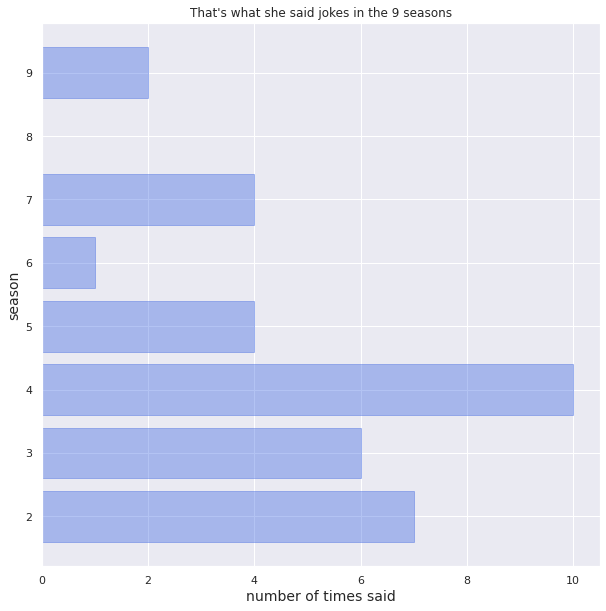

In [94]:
fig = plt.figure(figsize=(10, 10))

plt.barh(list(thats_what_she_said_count.keys()), thats_what_she_said_count.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xlabel('number of times said', fontsize=14)
plt.ylabel('season', fontsize=14)
plt.title("That's what she said jokes in the 9 seasons")


plt.show()

The number of That's what she said jokes starts in season 2 and grows until season 4, then the joke is not said so often anymore. In season 8, when Michael leaves, no one says it. 

Then, in season 9, it is said again Once by Michael and once by Creed. 

Let's now look into how says it the most:

In [95]:
thats_what_she_said_df = thats_what_she_said['speaker'].value_counts().reset_index()[:3]
thats_what_she_said_df.columns = ['Speaker', 'Number of Times Said']
thats_what_she_said_df

,Speaker,Number of Times Said
0,Michael,23
1,Dwight,3
2,Jim,2


In [96]:
def plot_fig(value, text):
    fig = go.Figure(go.Indicator(
    mode = 'number',
    value = value,
    title = {'text': text}
    ))
    fig.show()

In [97]:
plot_fig(int(thats_what_she_said_df.loc[thats_what_she_said_df['Speaker'] == 'Michael']['Number of Times Said']), 
         "Number of times Michael says: That's what she said")

#### Dunder Mifflin, this is Pam

As the receptionist, for the first 4 seaons, whenever Pam was answering the phone, she was said: 'Dunder Mifflin, this is Pam'. Let's look into how many times she actually said it:
<img src="imgs/pam.gif"/>


In [98]:
dunder_miffin_pam = transcripts_df[transcripts_df['line'].str.contains("Dunder Mifflin, this is Pam|Dunder Mifflin this is Pam", 
                                                        flags=re.IGNORECASE, regex=True)]

In [99]:
plot_fig(dunder_miffin_pam.shape[0], 
         'Number of times Pam said: Dunder Mifflin, this is Pam')

#### Number of times Angela talks about her Cats

<img src="imgs/angela.gif"/>


In [100]:
angela_cats = transcripts_df[transcripts_df['line'].str.contains("cat|cats", 
                                                        flags=re.IGNORECASE, regex=True)]
angela_cats = angela_cats.loc[angela_cats['speaker'] == 'Angela']

In [101]:
plot_fig(angela_cats.shape[0], 
         'Number of times Angela talks about her cats')

### Number of times Andy calls Jim Tuna

<img src="imgs/andy_tuna.gif" width=300 height=300/>

In [102]:
andy_tuna = transcripts_df[transcripts_df['line'].str.contains("tuna", 
                                                        flags=re.IGNORECASE, regex=True)]
andy_tuna = andy_tuna.loc[andy_tuna['speaker'] == 'Andy']

In [103]:
plot_fig(andy_tuna.shape[0], 
         'Number of times Andy calls Jim Tuna')

#### Number of times Kelly calls or talls about Ryan

<img src="imgs/kelly.gif" width=400 height=400/>

In [104]:
kelly_ryan = transcripts_df[transcripts_df['line'].str.contains("Ryan", 
                                                        flags=re.IGNORECASE, regex=True)]
kelly_ryan = kelly_ryan.loc[kelly_ryan['speaker'] == 'Kelly']

In [105]:
plot_fig(kelly_ryan.shape[0], 
         'Number of times Kelly calls or talls about Ryan')

#### Number of times Dwight says Assistant Regional Manager

<img src="imgs/dwight.gif"/>

In [106]:
dwight = transcripts_df[transcripts_df['line'].str.contains("assistant regional manager", 
                                                        flags=re.IGNORECASE, regex=True)]
dwight = dwight.loc[dwight['speaker'] == 'Dwight']

In [107]:
plot_fig(dwight.shape[0], 
         'Number of times Dwight says Assistant Regional Manager')

# Data Analysis

What we want to analyse:

- Create communities  **(done)**
- Wordclouds for each character based on their descriptions **(done)**
- Explore character relationship based on the lines exchanged between them


- Impact on views of each character in relation with the lines spoken  **(done)**
- Special guest impact on the views in relation with the average number of views  **(done)**
- Rank based on the number of lines spoken in the show  **(done)**
- Wordclouds of each season  **(done)**
- Wordclouds for each character based on lines spoken  **(done)**
- Sentiment analysis for each episode based on episode description
    - Who was the happiest and the saddest character in the series every season? **(done)**
- Character development over the show based on the episode ratings and dialogue
- Rank of the highest rated episodes **(done)**
- Top highest voted episodes  **(done)**
- Number of guest starts who appear in each season  **(done)**
- See how ratings varied from season to season, to see how the popularity of the series changed.  **(done)**
- See how each episode director influenced the episode rating. **(done)**
- Compare the rating of episodes directed by the cast in comparison to the other directors.  **(done)**

## Word-clouds

As a first step, we look into which words the main characters use most frequently. For this, we create Wordclouds for the main character based on their descriptions extracted from the Dunderpedia and located in `data/characters.csv`. The word-clouds are calculated according to the characters TC-IDF.


We first extract a dataframe for the main characters (characters whose role is `Main Characters`)

In [108]:
main_characters_df = df.loc[df['Main Role'].isin(['Main Characters'])]
main_characters_df.head()

,Name,Main Role,Secondary Roles,Position,ImagePath,Branch,Links
7,Andy Bernard,Main Characters,"[Dunder Mifflin employees, Actors of Threat Le...",[Former Regional Manager],Andy_Bernard.jpeg,[Dunder Mifflin Scranton],"[Erin Hannon, Angela Martin, Unnamed Cousin, W..."
9,Angela Martin,Main Characters,"[Dunder Mifflin employees, Former employees, A...",[Former Head of Accounting],Angela_Martin.jpg,[Dunder Mifflin Scranton],"[Dwight Schrute, Robert Lipton, Andy Bernard, ..."
58,Clark Green,Main Characters,"[Males, Dunder Mifflin employees]",[Sales Rep.],Clark_Green.jpg,[Dunder Mifflin Scranton],"[Pete Miller, Kelly Kapoor, Dwight Schrute, An..."
63,Creed Bratton,Main Characters,"[Dunder Mifflin employees, Actors of Threat Le...",[Former Acting Regional Manager],Creed_Bratton.jpg,[Dunder Mifflin Scranton],"[Oscar Martinez, Dwight Schrute, Creed Bratton..."
69,Darryl Philbin,Main Characters,"[Dunder Mifflin employees, Warehouse worker, A...",[Former Warehouse Foreman],Darryl_Philbin.PNG,[Dunder Mifflin Scranton],"[Michael Scott, Kelly Kapoor, Val Johnson, Jad..."


Each character is described by a document. Thus, to construct the wordcloud for the main characters, one would need to preprocess the text in the document corresponding to each character. 

The preprocessing of any document is done as follows:
-  Retrieving the right Data: Each document has a simmilar, however at times distinct format. To accomplish for that, when substracting only relevant information, we make use of regular expressions. This regular expressions ensure that the header and the footer is ignored and only the relevant sections of the document are considered.

-  Compile the HTML code, get rid of the specific patterns, e.g. Term, Cite, Color, Main, Compendium etc - since the raw data makes use of links, to avoid repeating words we carefully extract the data from the file using regex patterns, (tailored to these specific file types) and convert it into an appropriate format. Since the order of the words for this specific task is not important, the words in the right format can be later appended to the file.

- Tokenize Data -> LowerCase -> Lemmantize

However, the first step was preprocessing the data, this is done in the `PreprocessCharacterDescriptions.ipynb` notebook. 

In this notebook, regular expression were used to extract the content description of each character page. Different characters have different formats in which their data is presented More specifically, 12 different formats were identified, and 5 dfferent regrex expressions were built. Besides, in which character description, we can find information about the character development throught the sesons where the character played. This information which included along with the character biography/description to give a more meainful meaning of their characters and hence obtain more precise word-clouds. 

Then regrex patters were created to remove HTML elements, citation and link formats. The formats were removed, and the content was preserved. 

At the end of the preprocessing process, the data is saved to a file, `data/main_characters_tokens.csv`. We use this csv file to continue our work from here on.


In [109]:
with open('data/main_characters_tokens.csv') as file:
    main_characters_documents = json.loads(file.read())    

For the wordcloud, apart from the document tokens, we would need to compute the TC-IDF of the words. 
Computing the Document Frequency **df** of a word is a prerequisite for computing the TC-IDF. Computing the **df** for a specific race is done by using a global dictionary **df** - that holds a set of unique words that occurs in every document (character name). The word in the **df** dictionary maps to a value describing the number of files in which this word occurs.

Having the **tokens**, **df**, **N** - TC-IDF is computed as follows: 
-  we use the nltk.Text() method to easily compute the the number of occurences of a word **t** in a file
-  loop through each word **t** in the list of **tokens**
    -  compute **tc** (term count only) - using nltk.Text().count(token) method.
    -  compute the **idf** - log(N/df[t]), where **N** is the number of documents and df[t] is the document frequency of the word **t**.
    -  compute **tc_idf** as **tc * idf**

In [110]:
# This function computes the Document Frequency of a word across multiple documents
def calculate_df(document):
    document_df = {}
    unique = set(document)
    for u in unique:
        if u not in df:
            document_df[u] = 1
        else:
            document_df[u] += 1
    
    return document_df


# N is number of documents
def calculate_tc_idf(tokens, document_df, N):
    tc_idf = {}
    nltk_tokens = Text(tokens)
    
    # token_length = len(tokens)
    for t in tokens: 
        # tf = counter[t]/token_length 
        tc = nltk_tokens.count(t)
        
        idf = np.log(N/document_df[t]) 
        tc_idf[t] = tc*idf

    return tc_idf

Having everything in place, we can compute the `tc_idf` for every word beloging to each main character document. 

In [111]:
tc_idf_by_character = {}
len_documents = len(list(main_characters_documents.values()))
for character_name, tokens in main_characters_documents.items(): 

    document_df = calculate_df(tokens)
    tc_idf_by_character[character_name] = calculate_tc_idf(tokens, document_df, len_documents)

In [112]:
wordcloud_strings = {}
for name, tokens in tc_idf_by_character.items():
    wordcloud_strings[name] = ""

    for word, frequency in tokens.items():
        frequency = round(frequency)
        wordcloud_strings[name] += f"{word} " * frequency

Next we construct the word clouds for each character

# TODO: find maksks for all 25 main charactes: We should explain by some characters mention others. For example, by pam mentions jim and michael

In [113]:
from PIL import Image
main_path = './masks/'
file_names = {'Dwight Schrute':'Dwight-Schrute.png', 'Andy Bernard': 'andy.png', 'Pam Beesly':'pam.png', \
              'Angela Martin': 'angela.png'} 

fig = plt.figure(figsize=(350, 280))

for name, num in zip(list(wordcloud_strings.keys()), range(1,25)):# loop through the keys of the wordcloud_strings dictionary (every race) 

    converted = np.where(data == 255, 255, 0)
  
    vals = np.linspace(0,1,256) # initialize a matrix of color values
    np.random.shuffle(vals)     # randomize them    
    
    wordcloud = WordCloud(
        max_words= 200,
#         mask=np.array(Image.open(main_path + file_names[name])),  
        background_color='white',
        collocations=False, contour_width=3, contour_color='steelblue',
        colormap= plt.cm.colors.ListedColormap(plt.cm.jet(vals)) # use the randomized colormap
    ).generate(wordcloud_strings[name]) # we index the wordcloud_string dictionary based on race
    
    ax = fig.add_subplot(5, 5, num)
    ax.imshow(wordcloud)
    ax.axis('off')
    ax.set_title(name, fontsize=330)
plt.show()

We can see that the wordclouds of the majority of characters include names of other characters, specially Michael's. Since The Office is based on conversations between co-workers, it makes sense that the most comon tokens are character names. However, the main names in each character wordcloud are related to their professional of intimate relations. For example: 
- Angela had an affair with Dwight while she was daiting Andy.  
- Jim is married to Pam and works close to Dwight.
- Kelly is in love with Ryan for most of the series. 
- Kevin works with Angela in the Accounting department.
- Roy Anderson was married to Pam before Jim. 

However, we can see that Dwight and Michael do not have any character names in their word-clouds. On the other hand, Dwight has his surname: `Schrute`. Thorught the seasons, he repeately shows that he is proud of being a Schrute. He also talkes a lot about the fact that he is german, and about the Shrute farm that belonged to his family in the past. 

# TODO: Comment about the wordclouds

# Communities

Next, look at all the characters in our network, we will try to find communities by branch and compute their associated TF-IDF

In [114]:
best_partition_louvain = community_louvain.best_partition(G_undirected) 

In [115]:
count = len(set(best_partition_louvain.values()))   #counting the nr of communities

print(f'We found {count} communities using Louvain')

We found 8 communities using Louvain


Next we will compute the value of the modularity with the partition created by the Louvain algorithm. 
To compute the modularity value, we use the previously computed `best_partition_louvain` dictionary - mapping all nodes to community numbers, and group the nodes in the graph based on their community number instead.

In [116]:
# calculating the modularity using networkx.algorithms.community.quality.modularity

communities = {}    
for node, community_number in best_partition_louvain.items():
    if community_number not in communities:
        communities[community_number] = [node]
    else:
        communities[community_number].append(node)   

# it is done so that the node sets represent a partition of G's nodes

communities_list = list(communities.values())
modularity = nx_comm.modularity(G_undirected, communities_list)        #Returns the modularity of the given partition of the graph.

print(f'The modularity of the Louvain based partition is :{modularity:.3f}')

The modularity of the Louvain based partition is :0.347


To further examine the communities, we will plot the distribution of the community sizes. 

Each community is identified with the TOP 3 characters from each community (based on their degree in the network). 

We use the graph G_undirected to extract the 3 nodes with the highest degree, i.e. the three most connected nodes in each comunity. This will be used to name each community, as the exercise suggests.

In [117]:
top_3_in_community = {}

# sort the communities in descending order based on value size - useful later
communities = dict(sorted(communities.items(), key=lambda k: len(k[1]), reverse=True))

for community, nodes in communities.items(): 
    # create a list of tuples containing the node (n) and its degree (d) - for the communitiy nodes
    community_degrees = [(n,d) for n,d in G_undirected.degree(nodes)] 
    # sort the community_degrees= from high to low by degree (second element in the tuple - at index 1)
    community_degrees.sort(reverse=True, key=lambda x: x[1])
    
    top_3_in_community[community] = [n for (n,d) in community_degrees[:3]] # get index 0,1 and 2 as the top degree nodes

Next, we plot the distribution of community sizes with the appropriate x and y labels.

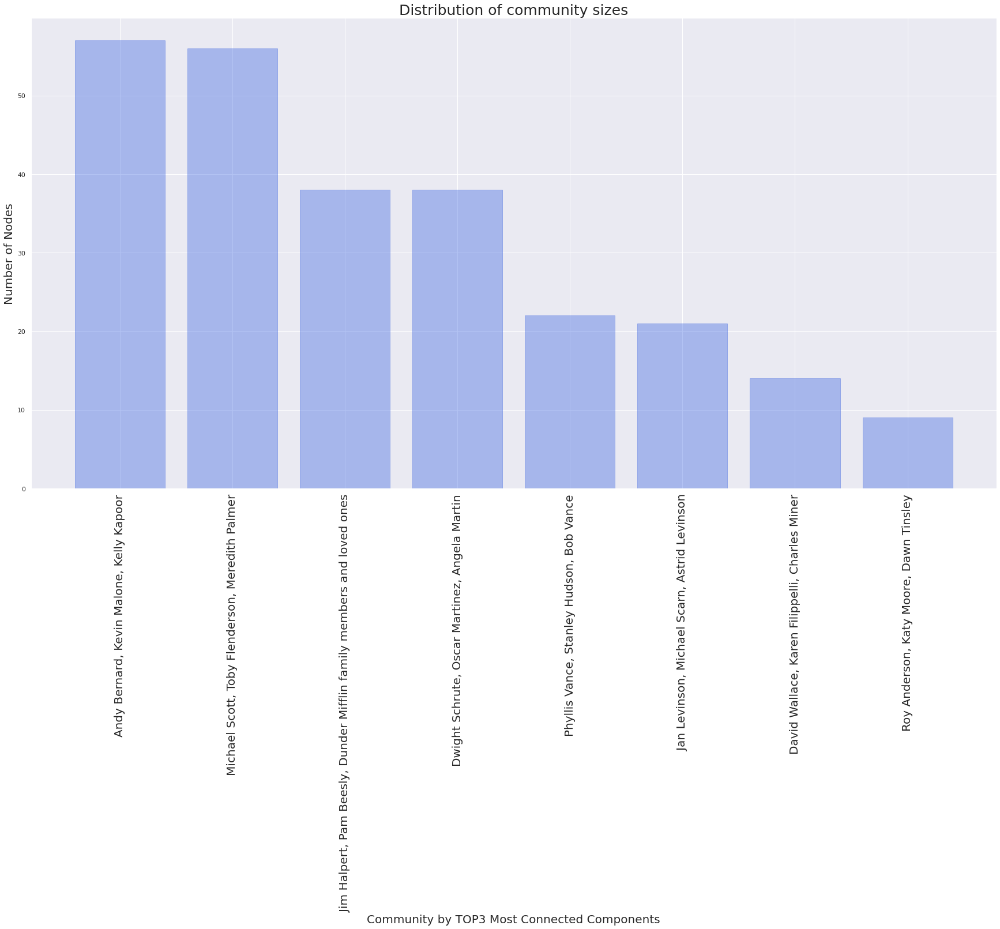

In [118]:
# plot of the distribution
plt.figure(figsize=(30,15))

# name each community by its 3 most connected components
communities_x = [', '.join(x) for x in top_3_in_community.values()] 
communities_y = [len(c) for c in communities.values()]  #number of nodes in each list

plt.bar(communities_x, communities_y,  color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xticks(communities_x, rotation=90, fontsize=20)   #rotate so that Harry (Breath of the Wild) fits among others.
plt.xlabel('Community by TOP3 Most Connected Components', fontsize=20)
plt.ylabel('Number of Nodes', fontsize=20)
plt.title("Distribution of community sizes", fontsize=25)
plt.show()

Next, we look at the five largest communities, and we create TF-IDF based rankings of words in each community.

In [119]:
# sort the communities based on their size, get the top 5 elements
top_five_communities = list(communities.items())[:5]

print("Five largest communities are denoted by these first character names:")

[top_3_in_community[c] for c, nodes in top_five_communities] # select first element from each list

Five largest communities are denoted by these first character names:


[['Andy Bernard', 'Kevin Malone', 'Kelly Kapoor'],
 ['Michael Scott', 'Toby Flenderson', 'Meredith Palmer'],
 ['Jim Halpert', 'Pam Beesly', 'Dunder Mifflin family members and loved ones'],
 ['Dwight Schrute', 'Oscar Martinez', 'Angela Martin'],
 ['Phyllis Vance', 'Stanley Hudson', 'Bob Vance']]

Save top five communities to file so the pages for each character in the top five communities can be divided into tokens.

In [120]:
with open('data/top_five_communities.csv', 'w') as file:
    file.write(json.dumps(top_five_communities))

To calculate TF-IDF we can reuse the functions defined in the previous part. The only difference right now is the way we compute the `tf` for every word. Previously `tf` represented the number of occurences of a word in a document. This time this number is also divided by the total number of words in the respective document. In other words, `tf` this time is normalized.
Overall, the new `calculate_tf_idf` function will have a similar structure to `calculate_tc_idf` and is written as follows:

In [121]:
# N is number of documents
def calculate_tf_idf(tokens, document_df, N):
    tf_idf = {}
    nltk_tokens = Text(tokens)
    
    token_length = len(tokens)
    for t in tokens: 
        tf = nltk_tokens.count(t)/token_length
        
        idf = np.log(N/document_df[t]) 
        tf_idf[t] = tf*idf

    return tf_idf

The way the TF-IDF is computed can be analyzed in the code above. Essentially the structure of the code is simmilar to the one in the previous part. The only difference is the fact that this time the `tf` is normalized by the length of the document.

First, the previously defined `df` is computed for the list of documents - belonging to the community characters. Then, for every list of tokens in the documents of each community character we compute the `tf_idf`. As written previously, to calculate TF-IDF we can reuse the functions defined in the previous part. The only difference right now is the way we compute the `tf` for every word. Previously `tf` represented the number of occurences of a word in a document. This time this number is also divided by the total number of words in the respective document. In other words, `tf` this time is normalized.
Overall, the new `calculate_tf_idf` function will have a similar structure to `calculate_tc_idf` and is defined in the `calculate_tf_idf` function.

The choice to reuse previous code and structure was motivated by usability, readability, and adaptability of the code that essentially performs the same tasks.

In [122]:
def calculate_community_df(documents):
    document_df = {}
    for tokens in documents:
        unique = set(tokens)
        for u in unique:
            if u not in df:
                document_df[u] = 1
            else:
                document_df[u] += 1
    
    return document_df

***Note: Make sure to run PreprocessCharacterDescriptions.ipynb before loading the community dict file***

In [123]:
with open('data/community_dict.csv') as file:
    community_dict = json.loads(file.read())
    
tf_idf_by_community = {}
for character_rep, documents in community_dict.items(): 

    document_df = calculate_community_df(documents)
    tf_idf_by_community[character_rep] = []
    for tokens in documents:
        tf_idf_by_community[character_rep].append(calculate_tf_idf(tokens, document_df, len(documents))) 

Now we have the TDF-IDF of every community, next we list the 5 top words for each community according to the TF-IDF. The idea behind computing the `tf-idf` for every word is having a set of words across all the documents belonging to the community. Then, one can loop through the unique words, check their number of occurrences in each file, and increment it if necessary. At the end, by maintaining the unique set of tokens per communities, we are guaranteed to have the correct frequency number for each word, in other words - its number of occurences in each file for every file in the community.

In [124]:
community_top_words_by_tf_idf = {}
for community, documents in tf_idf_by_community.items():
    community_top_words_by_tf_idf[community] = {} 
    unique_set = {}
    for tokens in documents: 
        for token, tf_idf in tokens.items():
            if token not in unique_set:
                unique_set[token] = tf_idf
            else:
                unique_set[token] += tf_idf
    community_top_words_by_tf_idf[community] = \
                                    (dict(sorted(unique_set.items(), key=lambda item: item[1], reverse=True)))

# loop through the community top words (which contains the words in sorted order by tf_idf) 
# and take the first 5 elements
top_five = {}
for community, words in community_top_words_by_tf_idf.items():
    top_3 = str(top_3_in_community[int(community)])
    top_five[top_3] = []
    
    count = 0
    for word in words:
        if count == 5: break 
        top_five[top_3].append(word)
        count += 1

In [125]:
for top_3, words in top_five.items():
    print(f'The top 5 words in the community represented by {top_3} are:\n\t {words}\n')

The top 5 words in the community represented by ['Jim Halpert', 'Pam Beesly', 'Dunder Mifflin family members and loved ones'] are:
	 ['michael', 'pam', 'jim', 'employee', 'party']

The top 5 words in the community represented by ['Dwight Schrute', 'Oscar Martinez', 'Angela Martin'] are:
	 ['dwight', 'angela', 'michael', 'oscar', 'minor']

The top 5 words in the community represented by ['Phyllis Vance', 'Stanley Hudson', 'Bob Vance'] are:
	 ['jim', 'pam', 'movie', 'michael', 'sophie']

The top 5 words in the community represented by ['Andy Bernard', 'Kevin Malone', 'Kelly Kapoor'] are:
	 ['toby', 'michael', 'jim', 'darryl', 'ryan']

The top 5 words in the community represented by ['Roy Anderson', 'Katy Moore', 'Dawn Tinsley'] are:
	 ['andy', 'erin', 'party', 'pete', 'mother']



# TODO: Describe the commuties and how the words identify each community.

# Transcripts Analysis

Now that we have characterized each community with the most important words (according to TF-IDF), let's analyse the sentiment of the main characters. 
The goal is now to perform sentiment analysis of each character in the series and create a wordcloud for each of them. Then we would like to compare this word cloud to the word-cloud description that we generated initially based on the Dundepedia pages. From the data download from the Dunderpedia, we could see that the main characters are: 


The goal is now to perform sentiment analysis of each character in the series and create a wordcloud for each main character in the series. From the data download from the Dunderpedia, we could see that the main characters are: 

In [126]:
print(f'The lead characters in The Office are: {main_character_names}')

The lead characters in The Office are: ['Andy', 'Angela', 'Clark', 'Creed', 'Darryl', 'Dwight', 'Erin', 'Gabe', 'Jan', 'Jim', 'Karen', 'Kelly', 'Kevin', 'Meredith', 'Michael', 'Nellie', 'Oscar', 'Pam', 'Pete', 'Phyllis', 'Robert', 'Roy', 'Ryan', 'Stanley', 'Toby']


## Sentiment Analysis

For the sentiment analysis, we will use the LabMT method. 

We first downloaded the LabMT wordlist. Then the LabMT wordlist was converted into a pandas dataframe `LabMT`, containing the file contents. This will be used later in the analysis.

To create the dataframe, we use the `read_csv` function from the pandas library, specify the file name, the row separator `\t`, the index of the header `0`, and the number of rows that need to be skipped until we get to the actual content: `3`. Some of the column values are set to `--`, we replace those with `NaN`, for easy usage in the analysis.


In [127]:
# parse file
LabMT = pd.read_csv('data/LabMT_Data_Set_S1.txt', sep="\t", header=0, skiprows=3)
LabMT = LabMT.replace('--', np.NaN) # replace -- with Nan
LabMT.head()

,word,happiness_rank,happiness_average,happiness_standard_deviation,twitter_rank,google_rank,nyt_rank,lyrics_rank
0,laughter,1,8.50,0.9313,3600,NaN,NaN,1728
1,happiness,2,8.44,0.9723,1853,2458,NaN,1230
2,love,3,8.42,1.1082,25,317,328,23
3,happy,4,8.30,0.9949,65,1372,1313,375
4,laughed,5,8.26,1.1572,3334,3542,NaN,2332


From the `LabMT` data, when calculating the sentiments, we are interested in getting the `happiness_average`. Hence, we create a function to get the `happiness_average` of a word. 

In [128]:
def get_happiness_average(word):
    """ Get the happiness average of a word from LabMT dataframe """
    if word in list(LabMT.word):
        return float(LabMT.loc[LabMT['word'] == word]['happiness_average'])
    return None

Next, we use the dialogs we dowloaded from Kaggle: `The-Office-Lines-V4.csv` and that we have previously extracted in a dataframe. This dataframe contains all the lines that were said in The Office during the 9 seasons, along with the character (speaker) for each line.

For the sentiment analysis of the character lines, we need to convert the lines into a list of tokens, using the same strategy as in the word-clourds, with the function `get_tokens`. For each character:

    1. Divide the dialog string into tokens using `WordPunctTokenizer.tokenize()`
    2. Remove non-alpha numeric tokens
    3. Convert the tokens to lower case, excludingh stop-words.
    4. Lemantize the token using `WordNetLemmantizer`

In [129]:
def get_tokens(lines, character_names=None):
    filtered_tokens = [] 
    for processed_text in lines:
        # 3. Tokenize content
        tk = WordPunctTokenizer()
        tokens = tk.tokenize(processed_text) 

        # 4. Remove non-alpha numeric tokens
        tokens = list(filter(lambda t: t.isalpha(), tokens))

        stop_words = set(stopwords.words('english')) 
        lemmatizer = WordNetLemmatizer()  # used to lemantize the words

        for t in tokens: 
            t_lower = t.lower() # convert text to lowercase
            if t_lower in stop_words: continue
            if character_names and t_lower in character_names: continue
            t_lower_lemantized = lemmatizer.lemmatize(t_lower) # lemantize the lowercase word
            
            filtered_tokens.append(t_lower_lemantized) # add it to the final list of tokens
    return filtered_tokens

In [130]:
# create a dictionary, mapping each speaker to lines (said by that speaker)
transcripts_df_grouped = main_character_transcripts_df.groupby(by='speaker')['line'].apply(list).to_dict

In [131]:
characters_tokens = {}
for character, lines in transcripts_df_grouped.items():
    tokens = get_tokens(lines, list(df.Name))
    characters_tokens[character] = tokens

AttributeError: 'function' object has no attribute 'items'

Once the tokens have been calculated, and the LabMT data has been preprocessed, the sentiments can be calculated for each token.  

To calculate the sentiment of a list of tokens, we created the `get_token_sentiment` function. This function does the following: 

   1. Calculates the frequency (number of occurences) of each token in the list of tokens of a dialog. 
    
   2. For each token in the list of tokens, calculate the sentiment score, `sentiment`. The sentiment score of a token is given by the frequency of that token in the token list `freq_dist[token]` multipled by the hapiness average of the token. 
    The hapiness average is obtained from the LabMT dataframe `happiness_average` column. We encountered that not all tokens are present in the LabMT dataframe. When this is the case, the token is just ignored.
    
   3. The average sentiment of the token list is then calculated. 

In [ ]:
def get_token_sentiment(tokens):
    freq_dist = dict(nltk.FreqDist(tokens)) # calculate frequency of tokens
    
    sentiment = 0
    total_freq = 0 # keept track of the total frequency for all tokens
    # we do not use all tokens as some of them are not present in the LabMT dataset, and those are ignored. Hence we cannot just use the sum over the freq_dist
    
    for token in tokens:
        hapiness_avg = get_happiness_average(token)
        if not hapiness_avg: continue # ignore token if not present in LabMT

        sentiment += freq_dist[token] * hapiness_avg
        total_freq += freq_dist[token]
        
    avg_sentiment = sentiment/total_freq
    
    return avg_sentiment

The sentiments for the character lines (parsed into a list of tokens) are then calculated using the above described `get_token_sentiment` function.  sentiments are stored in a dictionary, where the key is the character and the value is the sentiment score of the characters dialog.

In [ ]:
sentiments = {}
for character, tokens in characters_tokens.items():
    sentiment = get_token_sentiment(tokens) 
    sentiments[character] = sentiment

To analysis the character's associated sentuments, we create a histoigram.

In [ ]:
plt.figure(figsize=(10, 5))
plt.hist(sentiments.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xlabel('sentiment score', fontsize=14)
plt.ylabel('count', fontsize=14)
plt.title('Histogram of all characters associated transcripts-sentiments using the LabMT method')
plt.show()

From the above histogram, we can see a variation on the character sentiments. We can further use the calculated sentiments to get the happiest and saddest characters based on their transcripts during the 9 seasons. We focus on the 10 happiest and saddest characters. 

To get the 10 happiest and saddest characters, we sort the sentiments dictionary by sentiment from high to low, and return the first and the last 10 characters, where the first 10 represent the happiest and the last 10 the saddest characters.

In [ ]:
sorted_sentiments = {character: sentiment for character, sentiment in sorted(sentiments.items(), key=lambda item: item[1], reverse=True)}

In [ ]:
fig, ax = plt.subplots(figsize=(25,10))

happy_bar = ax.plot(list(sorted_sentiments.keys()), list(sorted_sentiments.values()), color='royalblue')
plt.plot(list(sorted_sentiments.keys()), list(sorted_sentiments.values()),'o',  color='orange')

plt.xticks(list(sorted_sentiments.keys()), rotation=90, fontsize=20)   #rotate so that Harry (Breath of the Wild) fits among others.

ax.set_xlabel('character', fontsize=20)
ax.set_ylabel('sentiment score', fontsize=20)
ax.set_title('Characters based on sentiment score', fontsize=25)

add_y_values_to_plot(sorted_sentiments.keys(), sorted_sentiments.values())


plt.show()

Now we can look more in depth into the character transcripts by looking at the polarity of the different dialogs. For this, we use the VADER method. We apply the `sentimentIntensityAnalyzer().polarity_scores` method the from `vaderSentiment` library to the characters dialogs dictionary. For this we first create a `SentimentIntensityAnalyzer`.

In [ ]:
analyzer  = SentimentIntensityAnalyzer()

Unlike when we used the LabMT method, now with the VADER data, we are going to keep punctuation and ALL-CAPS words. Hence, we keep the data as in the original dataframe `transcripts_df_grouped`, without any modifications. Then for each character dialog, we calculate the polarity of each sentence in the dialog using the `polarity_scores` function. Then we calculate the average polarity scores for each character.

In [ ]:
character_polarity = {}
for character, transcript in transcripts_df_grouped.items():
    transcript_polarity = []
    for line in transcript: 
        line_polarity = analyzer.polarity_scores(line)['compound']
        transcript_polarity.append(line_polarity)
        
    character_polarity[character] = np.mean(transcript_polarity)

As we did with the LabMT method, we now create a histogram for the character polarities. It is important to note that 
- a polarity score represents a positive sentiment when is $>=0.05$
- a polarity score represents a neutral sentiment when $0.05 < polarity > -0.05$
- a polarity score represents a negative sentiment when is $<= -0.05$

In [ ]:
plt.figure(figsize=(10, 5))
plt.hist(character_polarity.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.xlabel('polarity score')
plt.ylabel('count')
plt.title('Histogram of all characters associated dialogue-sentiments using the Vader method')
plt.show()

From the above plot we can see that all the characters are either neutral or positive, but not negative. We can now classify the sentiments based on the polarity to see a more clear distribution.

In [ ]:
def polarity_to_text(x):
    if x >= 0.05:
        return 'positive'
    elif x <= -0.05:
        return 'negative'
    else:
        return 'neutral'
    
polarities = list(map(lambda x: polarity_to_text(x),character_polarity.values()))
polarities_count = {'negative': polarities.count('negative'),
                    'positive': polarities.count('positive'),
                    'neutral': polarities.count('neutral')
                   }

plt.bar(polarities_count.keys(), polarities_count.values(), color='royalblue',alpha=0.4,edgecolor='royalblue')
plt.show()

As we saw in the first VADER histogram, there are no negative sentiments. The majority of sentiments are positive, and only a few are neutral. Let's now look at who are the happiest and the saddest character based on the Vader method:

In [ ]:
sorted_polarities = {character: polarity for character, polarity in sorted(character_polarity.items(), key=lambda item: item[1], reverse=True)}

In [ ]:
fig, ax = plt.subplots(figsize=(25,10))

ax.plot(list(sorted_polarities.keys()), list(sorted_polarities.values()), color='royalblue')
plt.plot(list(sorted_polarities.keys()), list(sorted_polarities.values()),'o',  color='orange')

plt.xticks(list(sorted_polarities.keys()), rotation=90, fontsize=20)   #rotate so that Harry (Breath of the Wild) fits among others.

ax.set_xlabel('character', fontsize=20)
ax.set_ylabel('sentiment score', fontsize=20)
ax.set_title('Characters based on sentiment score', fontsize=25)

add_y_values_to_plot(sorted_polarities.keys(), sorted_polarities.values())

plt.show()

We can see that Clark Green is the most positive character in the office. However, he was only present in season 9. Michael, present in 7 seasons, is the most positive character after Clark. This makes sense as he is the regional manager as his job is to be friends with everyone and motivate them. Among the most positives we can also find Jim and Pam who are always friendly to everyone. Besides, Pam is the receptionist for the first 4 seasons, which implies that she needs to have a positive approach towards others in the office and those calling.

Starting from Dwight, the characters start being more neutral than positive. Specially the fact that Angela, Meredith and Stanley are the least positive. These three characters are always mean to everyone and generally unhappy in comparison to the rest. They always criticize other's actions, and never show positive reactions. 

As we did before, we will look into the characters sentiment development through the seasons. 

In [ ]:
fig = plt.figure(figsize=(120, 150))

for season, num in zip(main_character_transcripts_df['season'].unique(), range(1,10)):# loop through the keys of the wordcloud_strings dictionary (every race) 
    
    transcripts_df_grouped = main_character_transcripts_df. \
            loc[main_character_transcripts_df['season'] == season] \
            .groupby(by='speaker')['line'].apply(list).to_dict()
    
    character_polarity = {}
    for character, transcript in transcripts_df_grouped.items():
        transcript_polarity = []
        for line in transcript: 
            line_polarity = analyzer.polarity_scores(line)['compound']
            transcript_polarity.append(line_polarity)
        
        character_polarity[character] = np.mean(transcript_polarity)
    
    sorted_polarities = {character: polarity for character, polarity in sorted(character_polarity.items(), key=lambda item: item[1], reverse=True)}    

    ax = fig.add_subplot(3,3, num)
    ax.plot(list(sorted_polarities.keys()), list(sorted_polarities.values()), color='royalblue')
    ax.plot(list(sorted_polarities.keys()), list(sorted_polarities.values()),'o',  color='orange')
    ax.set_xticklabels(sorted_polarities.keys(), rotation=90, fontsize=20)   #rotate so that Harry (Breath of the Wild) fits among others.

    ax.set_xlabel('character', fontsize=62)
    ax.set_ylabel('sentiment score', fontsize=62)
    ax.set_title(f'season {season}', fontsize=62)


    plt.xticks(fontsize=62)
    plt.yticks(fontsize=62)

plt.show()

We can see that the character sentiments vary from season to season. It is also interesting to see that some seasons are more positive than others. For example, the first and fourth seasons are the only ones that include negative tokens. We will later on analyse if there is a relation between the writer of the episodes and the sentiments. 

Now we will create word-clouds for the 25 main characters based on the lines spoken thought the 9 seasons, and we will compare these to the previously generated wordclouds based on the descriptions from Dunderpedia.

In [ ]:
tc_idf_by_character = {}
len_documents = len(list(characters_tokens.values()))
for character_name, tokens in characters_tokens.items(): 

    document_df = calculate_df(tokens)
    tc_idf_by_character[character_name] = calculate_tc_idf(tokens, document_df, len_documents)

In [ ]:
wordcloud_strings = {}
for name, tokens in tc_idf_by_character.items():
    wordcloud_strings[name] = ""

    for word, frequency in tokens.items():
        frequency = round(frequency)
        wordcloud_strings[name] += f"{word} " * frequency

Next we construct the word clouds for each character

In [ ]:
from PIL import Image
main_path = './masks/'
file_names = {'Dwight Schrute':'Dwight-Schrute.png', 'Andy Bernard': 'andy.png', 'Pam Beesly':'pam.png', \
              'Angela Martin': 'angela.png'} 

fig = plt.figure(figsize=(350, 280))

for name, num in zip(list(wordcloud_strings.keys()), range(1,25)):# loop through the keys of the wordcloud_strings dictionary (every race) 

    converted = np.where(data == 255, 255, 0)
  
    vals = np.linspace(0,1,256) # initialize a matrix of color values
    np.random.shuffle(vals)     # randomize them    
    
    wordcloud = WordCloud(
        max_words= 200,
#         mask=np.array(Image.open(main_path + file_names[name])),  
        background_color='white',
        collocations=False, contour_width=3, contour_color='steelblue',
        colormap= plt.cm.colors.ListedColormap(plt.cm.jet(vals)) # use the randomized colormap
    ).generate(wordcloud_strings[name]) # we index the wordcloud_string dictionary based on race
    
    ax = fig.add_subplot(5, 5, num)
    ax.imshow(wordcloud)
    ax.axis('off')
    ax.set_title(name, fontsize=330)
plt.show()

Looking at the word-clouds generated from the transcripts, it can be seen that they do not tell much about the characters themselves, in comparison to the word-clouds obtained from the charaters's descriptions. 

For example, thanks to the word-cloud from Dwight's description, we could see that he was German, he was proud of his surname, and he lives in a farm. 

From these new word-clouds, most of the characters use the words: hey, know, right, oh and yeah. This makes sense, since they are constantly having converstations between each other. Besides, since these conversations happen in the workplace, whenever they have to approach a new character, they tend to say Hey. Also, this makes sense since Dwight and Jim are salesmen and Pam is the office receptionist for 4 seasons. As Pam is the receptionist, she calls Michael very often.

## Word-clouds for all seasons

In [ ]:
transcripts_df_grouped = transcripts_df.groupby(by='season')['line'].apply(list).to_dict()

characters_tokens = {}
for character, lines in transcripts_df_grouped.items():
    tokens = get_tokens(lines)
    characters_tokens[character] = tokens

In [ ]:
tc_idf_by_character = {}
len_documents = len(list(characters_tokens.values()))
for season, tokens in characters_tokens.items(): 

    document_df = calculate_df(tokens)
    tc_idf_by_character[season] = calculate_tc_idf(tokens, document_df, )

In [ ]:
wordcloud_strings = {}
for season, tokens in tc_idf_by_character.items():
    wordcloud_strings[season] = ""

    for word, frequency in tokens.items():
        frequency = round(frequency)
        wordcloud_strings[season] += f"{word} " * frequency

In [ ]:
fig = plt.figure(figsize=(200, 100))

for season, num in zip(list(wordcloud_strings.keys()), range(1, 10)):# loop through the keys of the wordcloud_strings dictionary (every race) 

    converted = np.where(data == 255, 255, 0)
  
    vals = np.linspace(0,1,256) # initialize a matrix of color values
    np.random.shuffle(vals)     # randomize them    
    
    wordcloud = WordCloud(
        max_words= 200,
        background_color='white',
        collocations=False, contour_width=3, contour_color='steelblue',
        colormap= plt.cm.colors.ListedColormap(plt.cm.jet(vals)) # use the randomized colormap
    ).generate(wordcloud_strings[season]) # we index the wordcloud_string dictionary based on race
    
    ax = fig.add_subplot(3, 3, num)
    ax.imshow(wordcloud)
    ax.axis('off')
    ax.set_title(f"Season {season}", fontsize=330)
    
plt.show()

## Character Interactions